In [1]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import AxesGrid
import xarray as xr
import os
import numpy as np
import logging
import cmocean
import copy

cmocean.cm.balance
cmap = copy.copy(cmocean.cm.balance)
cmap.set_bad('gray')   

pp_root_uncou = "/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/"
pp_root_uncou_LAfalse="/archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou_LALTFalse/"

def read_and_extract_data(pp_root, data_list, variables):
    combined_data = {}
    summer_data = {}
    winter_data = {}

    for var_name in variables:
        datasets = []
        summer_data_list = []
        winter_data_list = []

        for file_path in data_list:
            file_path = os.path.join(pp_root, file_path)
            if os.path.exists(file_path):
                try:
                    ds = xr.open_dataset(file_path)
                    if var_name in ds:
                        datasets.append(ds[var_name])

                        # Summer: June, July, August (JJA)
                        summer = ds.sel(time=ds['time'].dt.month.isin([6, 7, 8]))
                        if not summer[var_name].isnull().all():
                            summer_data_list.append(summer[var_name])

                        # Winter: December, January, February (DJF)
                        winter = ds.sel(time=ds['time'].dt.month.isin([12, 1, 2]))
                        if not winter[var_name].isnull().all():
                            winter_data_list.append(winter[var_name])

                    else:
                        print(f"Variable {var_name} not found in {file_path}")
                    ds.close()

                except Exception as e:
                    print(f"Error reading {file_path}: {e}")
            else:
                print(f"File not found: {file_path}")

        # Combine along time dimension after the loop finishes
        combined_data[var_name] = xr.concat(datasets, dim='time') if datasets else None
        summer_data[var_name] = xr.concat(summer_data_list, dim='time') if summer_data_list else None
        winter_data[var_name] = xr.concat(winter_data_list, dim='time') if winter_data_list else None

    return combined_data, summer_data, winter_data

# Example usage
data_list = [
    '19930101_results/19930101.ocean_daily.nc',
    '19930701_results/19930701.ocean_daily.nc',
    '19940101_results/19940101.ocean_daily.nc',
    '19940701_results/19940701.ocean_daily.nc',
    '19950101_results/19950101.ocean_daily.nc',
    '19950701_results/19950701.ocean_daily.nc',
    '19960101_results/19960101.ocean_daily.nc',
    '19970101_results/19970101.ocean_daily.nc',
    '19980101_results/19980101.ocean_daily.nc',
    '19990101_results/19990101.ocean_daily.nc',
    '20010101_results/20010101.ocean_daily.nc',
    '20020101_results/20020101.ocean_daily.nc',
    '20030101_results/20030101.ocean_daily.nc',
    '20040101_results/20040101.ocean_daily.nc',
    '20050101_results/20050101.ocean_daily.nc',
    '20060101_results/20060101.ocean_daily.nc',
    '20070101_results/20070101.ocean_daily.nc',
    '20080101_results/20080101.ocean_daily.nc',
    '20090101_results/20090101.ocean_daily.nc',
    '20100101_results/20100101.ocean_daily.nc',
    '20110101_results/20110101.ocean_daily.nc',
    '20120101_results/20120101.ocean_daily.nc',
    '20130101_results/20130101.ocean_daily.nc',
    '20140101_results/20140101.ocean_daily.nc',
    '20150101_results/20150101.ocean_daily.nc',
    '20160101_results/20160101.ocean_daily.nc',
    '20170101_results/20170101.ocean_daily.nc',
    '20180101_results/20180101.ocean_daily.nc',
    '20190101_results/20190101.ocean_daily.nc',

]

variables = ['SST', 'ssh', 'MLD_EN1', 'ssu', 'ssv']

combined_data_uncou, summer_data_uncou, winter_data_uncou = read_and_extract_data(pp_root_uncou, data_list, variables)
combined_data_uncou_LAfalse, summer_data_uncou_LAfalse, winter_data_uncou_LAfalse = read_and_extract_data(pp_root_uncou_LAfalse, data_list, variables)


In [3]:
def save_combined_data(variables, combined_data_dict, summer_combined_dict, winter_combined_dict,root,output_dir):
    for var_name in variables:
        try:
            # Access the combined data for this variable
            combined = combined_data_dict.get(var_name)
            summer_combined = summer_combined_dict.get(var_name)
            winter_combined = winter_combined_dict.get(var_name)
            

            # Save compressed files
            if combined is not None:
                
                output_path = os.path.join(output_dir, f'combined_data_{var_name}_{root}.nc')
                combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved combined data for {var_name}_{root} to {output_path}")
               
                

            if summer_combined is not None:
                output_path = os.path.join(output_dir, f'summer_data_{var_name}_{root}.nc')
                summer_combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved summer combined data for {var_name}_{root} to {output_path}")

            if winter_combined is not None:
                output_path = os.path.join(output_dir, f'winter_data_{var_name}_{root}.nc')
                winter_combined.to_netcdf(output_path, encoding={var_name: {'zlib': True, 'complevel': 5}})
                print(f"Saved winter combined data for {var_name}_{root} to {output_path}")

        except Exception as e:
            print(f"Error saving data for {var_name}_{root} to {output_path}: {e}")

# Example usage
save_combined_data(variables, combined_data_uncou, summer_data_uncou, winter_data_uncou,'uncou',pp_root_uncou)
save_combined_data(variables, combined_data_uncou_LAfalse, summer_data_uncou_LAfalse, winter_data_uncou_LAfalse,'uncou_LAfalse',pp_root_uncou_LAfalse)






Saved combined data for SST_uncou to /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/combined_data_SST_uncou.nc
Saved summer combined data for SST_uncou to /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/summer_data_SST_uncou.nc
Saved winter combined data for SST_uncou to /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/winter_data_SST_uncou.nc
Saved combined data for ssh_uncou to /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/combined_data_ssh_uncou.nc
Saved summer combined data for ssh_uncou to /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/summer_data_ssh_uncou.nc
Saved winter combined data for ssh_uncou to /archive/Qian.Xiao/Qian.Xiao/FMS_Wave_Coupling_ZC/postProcessing/NWA12.COBALTuncou/winter_data_ssh_uncou.nc


KeyboardInterrupt: 

In [ ]:
variables_LA = ['time','LA','LA_MOD','La_turbulent','MSTAR_LT']
LA_data_uncou, LA_summer_uncou, LA_winter_uncou = read_and_extract_data(pp_root_uncou, data_list, variables_LA)
LA_data_uncou_LAfalse, LA_summer_uncou_LAfalse, LA_winter_uncou_LAfalse = read_and_extract_data(pp_root_uncou_LAfalse, data_list, variables_LA)


In [ ]:
# Example usage
ocean_daily_uncou_LAfalse_1= xr.open_dataset(pp_root_uncou_LAfalse+"/19930101_results/19930101.ocean_daily.nc")
model_grid_x = ocean_daily_uncou_LAfalse_1.variables['xh']
model_grid_y = ocean_daily_uncou_LAfalse_1.variables['yh']

SST_uncou_ave= combined_data_uncou['SST'].mean(dim='time')
SST_summer_uncou_ave= summer_data_uncou['SST'].mean(dim='time')
SST_winter_uncou_ave= winter_data_uncou['SST'].mean(dim='time')
SST_uncou_LAfalse_ave= combined_data_uncou_LAfalse['SST'].mean(dim='time')
SST_summer_uncou_LAfalse_ave= summer_data_uncou_LAfalse['SST'].mean(dim='time')
SST_winter_uncou_LAfalse_ave= winter_data_uncou_LAfalse['SST'].mean(dim='time')

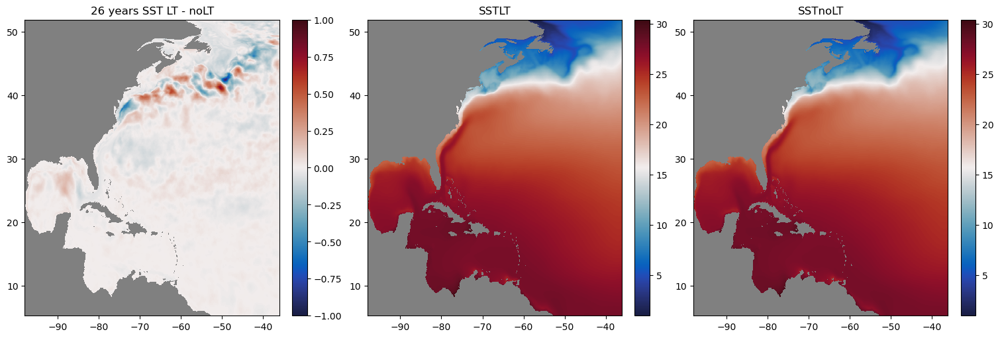

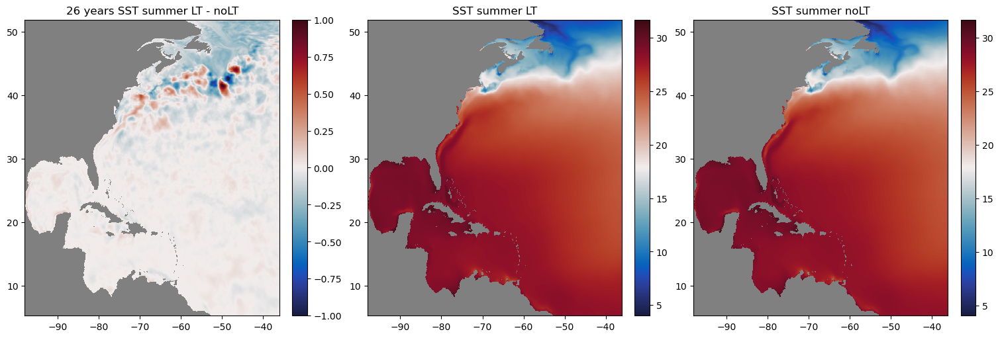

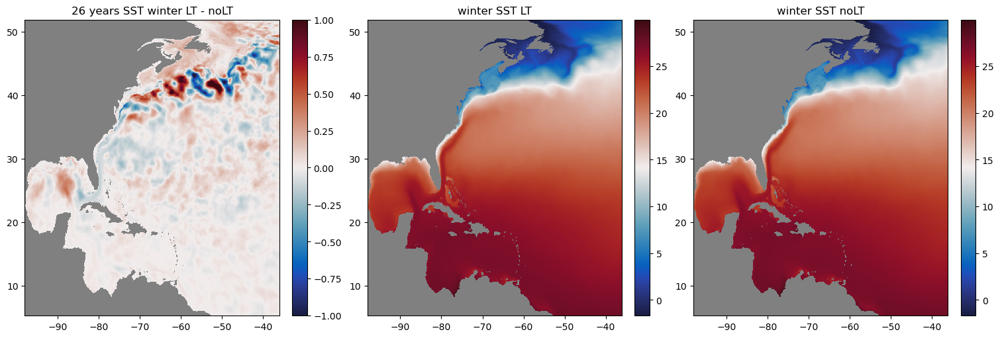

In [34]:


diff_SST_uncou_ave=SST_uncou_ave-SST_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_uncou_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('26 years SST LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('SSTLT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('SSTnoLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_SST_summer_uncou_ave=SST_summer_uncou_ave-SST_summer_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('26 years SST summer LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_summer_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('SST summer LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_summer_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('SST summer noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_SST_winter_uncou_ave=SST_winter_uncou_ave-SST_winter_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_SST_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-1,vmax=1)
axes[0].set_title('26 years SST winter LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, SST_winter_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('winter SST LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, SST_winter_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('winter SST noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()


In [ ]:
ssh_uncou_ave= combined_data_uncou['ssh'].mean(dim='time')
ssh_summer_uncou_ave= summer_data_uncou['ssh'].mean(dim='time')
ssh_winter_uncou_ave= winter_data_uncou['ssh'].mean(dim='time')
ssh_uncou_LAfalse_ave= combined_data_uncou_LAfalse['ssh'].mean(dim='time')
ssh_summer_uncou_LAfalse_ave= summer_data_uncou_LAfalse['ssh'].mean(dim='time')
ssh_winter_uncou_LAfalse_ave= winter_data_uncou_LAfalse['ssh'].mean(dim='time')

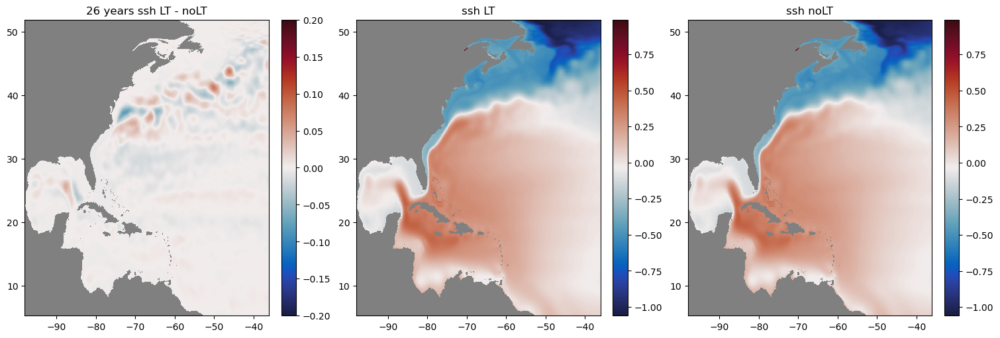

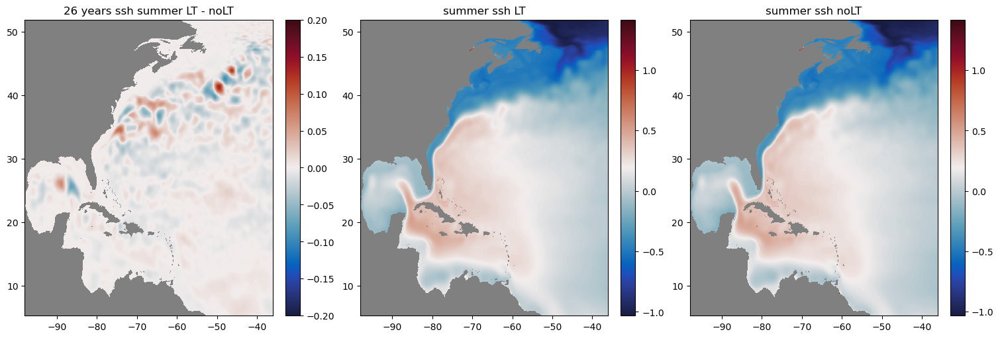

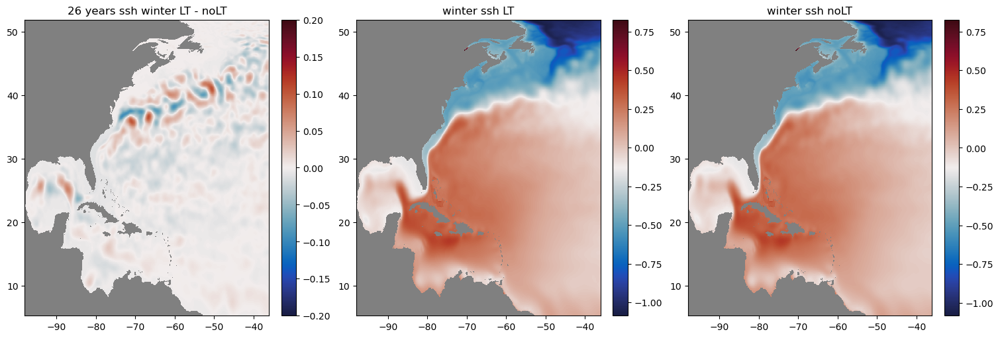

In [37]:


diff_ssh_uncou_ave=ssh_uncou_ave-ssh_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_uncou_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('26 years ssh LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('ssh LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('ssh noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ssh_summer_uncou_ave=ssh_summer_uncou_ave-ssh_summer_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('26 years ssh summer LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_summer_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('summer ssh LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_summer_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('summer ssh noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ssh_winter_uncou_ave=ssh_winter_uncou_ave-ssh_winter_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('26 years ssh winter LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_winter_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('winter ssh LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_winter_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('winter ssh noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

In [ ]:
MLD_EN1_uncou_ave= combined_data_uncou['MLD_EN1'].mean(dim='time')
MLD_EN1_summer_uncou_ave= summer_data_uncou['MLD_EN1'].mean(dim='time')
MLD_EN1_winter_uncou_ave= winter_data_uncou['MLD_EN1'].mean(dim='time')
MLD_EN1_uncou_LAfalse_ave= combined_data_uncou_LAfalse['MLD_EN1'].mean(dim='time')
MLD_EN1_summer_uncou_LAfalse_ave= summer_data_uncou_LAfalse['MLD_EN1'].mean(dim='time')
MLD_EN1_winter_uncou_LAfalse_ave= winter_data_uncou_LAfalse['MLD_EN1'].mean(dim='time')

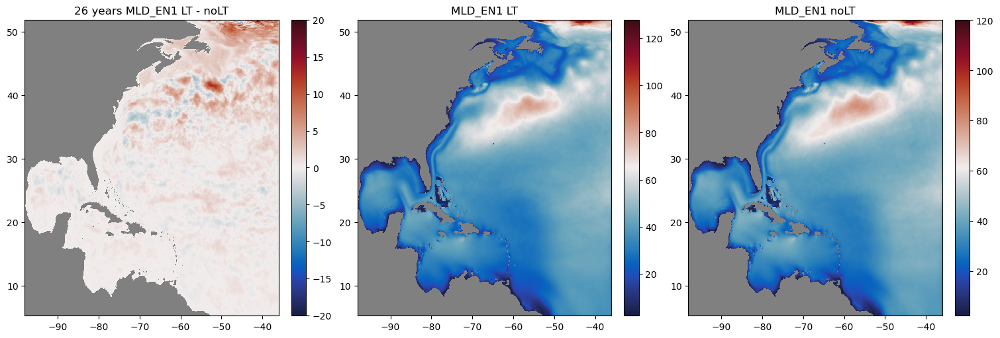

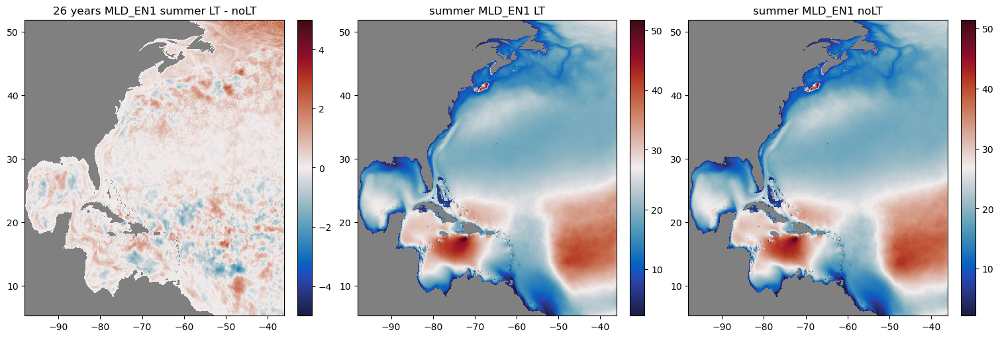

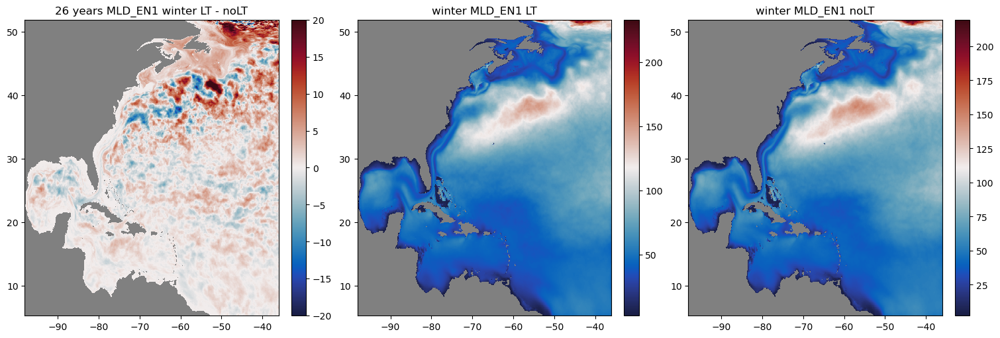

In [42]:


diff_MLD_EN1_uncou_ave=MLD_EN1_uncou_ave-MLD_EN1_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_ave , cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[0].set_title('26 years MLD_EN1 LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('MLD_EN1 LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('MLD_EN1 noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_MLD_EN1_summer_uncou_ave=MLD_EN1_summer_uncou_ave-MLD_EN1_summer_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-5,vmax=5)
axes[0].set_title('26 years MLD_EN1 summer LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('summer MLD_EN1 LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_summer_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('summer MLD_EN1 noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_MLD_EN1_winter_uncou_ave=MLD_EN1_winter_uncou_ave-MLD_EN1_winter_uncou_LAfalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-20,vmax=20)
axes[0].set_title('26 years MLD_EN1 winter LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('winter MLD_EN1 LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_winter_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('winter MLD_EN1 noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

In [43]:
ssu_uncou= combined_data_uncou['ssu']
ssu_summer_uncou= summer_data_uncou['ssu']
ssu_winter_uncou= winter_data_uncou['ssu']
ssu_uncou_LAfalse= combined_data_uncou_LAfalse['ssu']
ssu_summer_uncou_LAfalse= summer_data_uncou_LAfalse['ssu']
ssu_winter_uncou_LAfalse= winter_data_uncou_LAfalse['ssu']
ssv_uncou= combined_data_uncou['ssv']
ssv_summer_uncou= summer_data_uncou['ssv']
ssv_winter_uncou= winter_data_uncou['ssv']
ssv_uncou_LAfalse= combined_data_uncou_LAfalse['ssv']
ssv_summer_uncou_LAfalse= summer_data_uncou_LAfalse['ssv']
ssv_winter_uncou_LAfalse= winter_data_uncou_LAfalse['ssv']

ssu_uncou=ssu_uncou[:,:,1:]
ssv_uncou=ssv_uncou[:,1:,:]
ssu_uncou_LAfalse=ssu_uncou_LAfalse[:,:,1:]
ssv_uncou_LAfalse=ssv_uncou_LAfalse[:,1:,:]
ss_mag_uncou=np.sqrt(ssu_uncou**2+ ssv_uncou**2)
ss_mag_uncou_LAfalse=np.sqrt(ssu_uncou_LAfalse**2 + ssv_uncou_LAfalse**2)
ss_mag_uncou_ave=ss_mag_uncou.mean('time')
ss_mag_uncou_LAfalse_ave=ss_mag_uncou_LAfalse.mean('time')

ssu_summer_uncou=ssu_summer_uncou[:,:,1:]
ssv_summer_uncou=ssv_summer_uncou[:,1:,:]
ssu_summer_uncou_LAfalse=ssu_summer_uncou_LAfalse[:,:,1:]
ssv_summer_uncou_LAfalse=ssv_summer_uncou_LAfalse[:,1:,:]
ss_summer_mag_uncou=np.sqrt(ssu_summer_uncou**2+ ssv_summer_uncou**2)
ss_summer_mag_uncou_LAfalse=np.sqrt(ssu_summer_uncou_LAfalse**2 + ssv_summer_uncou_LAfalse**2)
ss_summer_mag_uncou_ave=ss_summer_mag_uncou.mean('time')
ss_summer_mag_uncou_LAfalse_ave=ss_summer_mag_uncou_LAfalse.mean('time')

ssu_winter_uncou=ssu_winter_uncou[:,:,1:]
ssv_winter_uncou=ssv_winter_uncou[:,1:,:]
ssu_winter_uncou_LAfalse=ssu_winter_uncou_LAfalse[:,:,1:]
ssv_winter_uncou_LAfalse=ssv_winter_uncou_LAfalse[:,1:,:]
ss_winter_mag_uncou=np.sqrt(ssu_winter_uncou**2+ ssv_winter_uncou**2)
ss_winter_mag_uncou_LAfalse=np.sqrt(ssu_winter_uncou_LAfalse**2 + ssv_winter_uncou_LAfalse**2)
ss_winter_mag_uncou_ave=ss_winter_mag_uncou.mean('time')
ss_winter_mag_uncou_LAfalse_ave=ss_winter_mag_uncou_LAfalse.mean('time')

diff_ss_mag_uncou_ave=ss_mag_uncou_ave-ss_mag_uncou_LAFalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ss_mag_uncou_ave , cmap=cmap, shading='auto',vmin=-2,vmax=2)
axes[0].set_title('26 years ss_mag LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ss_mag_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('ss_mag LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ss_mag_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('ss_mag noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ss_summer_uncou_ave=ss_summer_uncou_ave-ss_summer_uncou_LAFalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ss_summer_uncou_ave , cmap=cmap, shading='auto',vmin=-2,vmax=2)
axes[0].set_title('26 years ss_mag summer LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ss_summer_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('summer ss_mag LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ss_summer_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('summer ss_mag noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ss_winter_uncou_ave=ss_winter_uncou_ave-ss_winter_uncou_LAFalse_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ss_winter_uncou_ave , cmap=cmap, shading='auto',vmin=-2,vmax=2)
axes[0].set_title('26 years ss_mag winter LT - noLT')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ss_winter_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('winter ss_mag LT')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ss_winter_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('winter ss_mag noLT')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

MemoryError: Unable to allocate 14.5 PiB for an array with shape (9495, 845, 775, 845, 775) and data type float32

In [6]:
def calculate_ssh_gradient_nonuniform(SSH, xh, yh):
    grad_x = np.zeros_like(SSH)
    grad_y = np.zeros_like(SSH)
    
    # Loop over the interior points only to avoid boundary issues
    for j in range(1, len(yh) - 1):  # Loop over 'yh' (rows, y-direction)
        for i in range(1, len(xh) - 1):  # Loop over 'xh' (columns, x-direction)
            dx = xh[i+1] - xh[i-1]  # Local dx for point (j, i)
            dy = yh[j+1] - yh[j-1]  # Local dy for point (j, i)

            grad_x[j, i] = (SSH[j, i+1] - SSH[j, i-1]) / dx  # Gradient in x-direction
            grad_y[j, i] = (SSH[j+1, i] - SSH[j-1, i]) / dy  # Gradient in y-direction
    
    # Optionally, compute the gradient magnitude

    
    return grad_x, grad_y
    
gx_summer_wave,gy_summer_wave=calculate_ssh_gradient_nonuniform(ssh_wave_summer_ave, model_grid_x, model_grid_y)
gx_winter_wave,gy_winter_wave=calculate_ssh_gradient_nonuniform(ssh_wave_winter_ave, model_grid_x, model_grid_y)
gx_summer_all,gy_summer_all=calculate_ssh_gradient_nonuniform(ssh_all_summer_ave, model_grid_x, model_grid_y)
gx_winter_all,gy_winter_all=calculate_ssh_gradient_nonuniform(ssh_all_winter_ave, model_grid_x, model_grid_y)
gx_summer_uncou,gy_summer_uncou=calculate_ssh_gradient_nonuniform(ssh_uncou_summer_ave, model_grid_x, model_grid_y)
gx_winter_uncou,gy_winter_uncou=calculate_ssh_gradient_nonuniform(ssh_uncou_winter_ave, model_grid_x, model_grid_y)
gx_summer_uncou_LAfalse,gy_summer_uncou_LAfalse=calculate_ssh_gradient_nonuniform(ssh_uncou_LAfalse_summer_ave, model_grid_x, model_grid_y)
gx_winter_uncou_LAfalse,gy_winter_uncou_LAfalse=calculate_ssh_gradient_nonuniform(ssh_uncou_LAfalse_winter_ave, model_grid_x, model_grid_y)


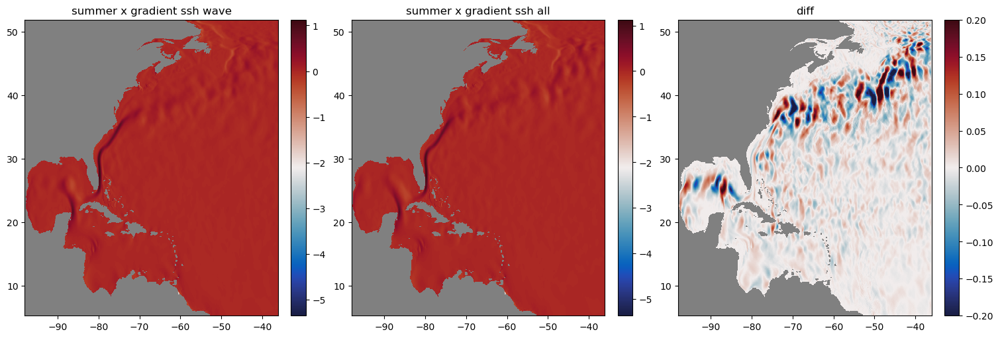

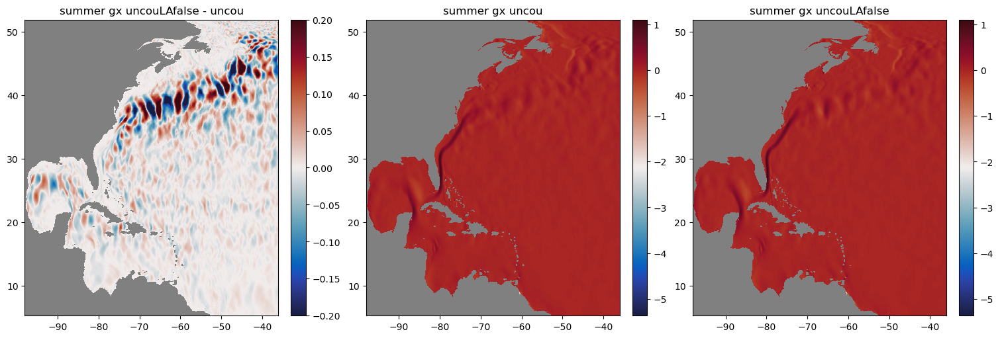

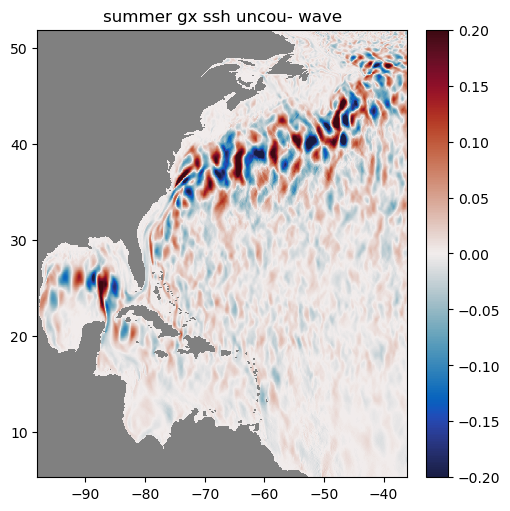

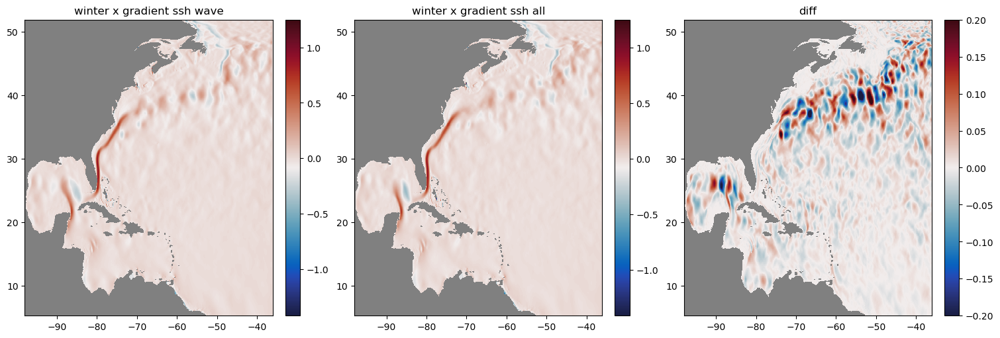

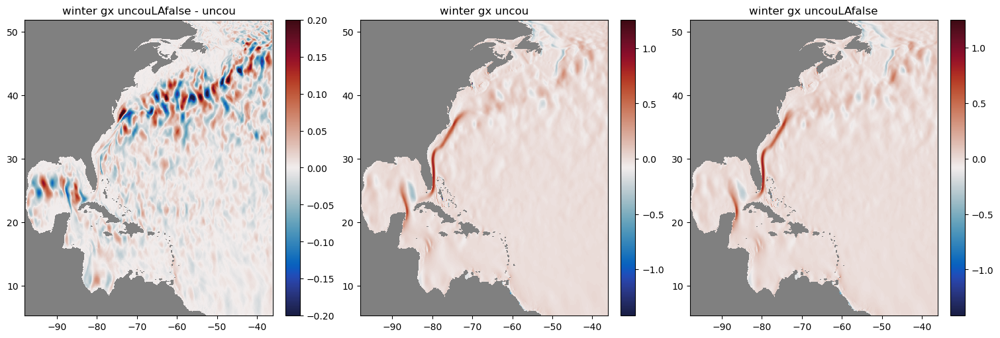

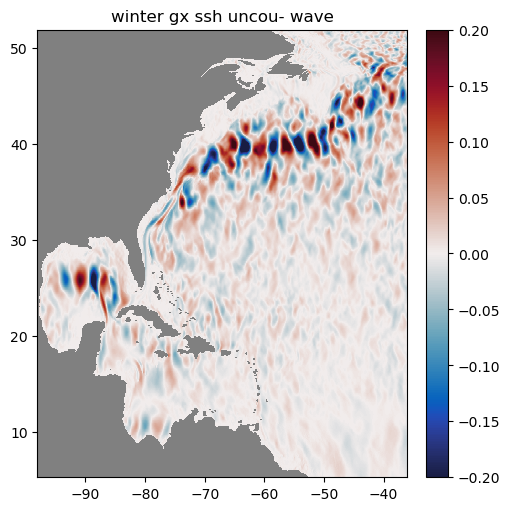

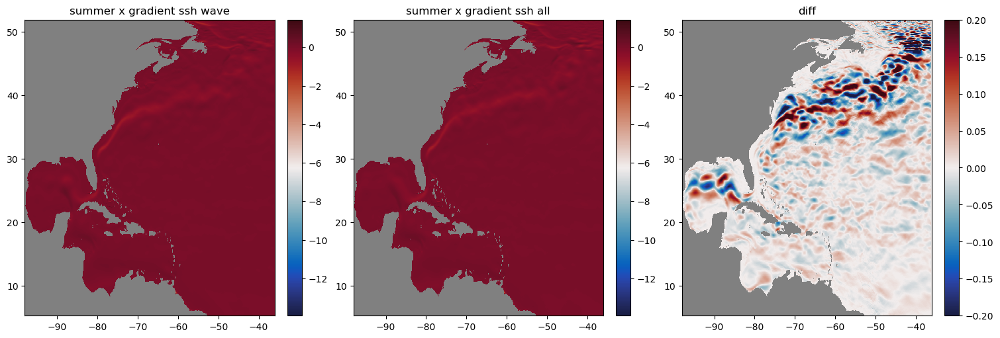

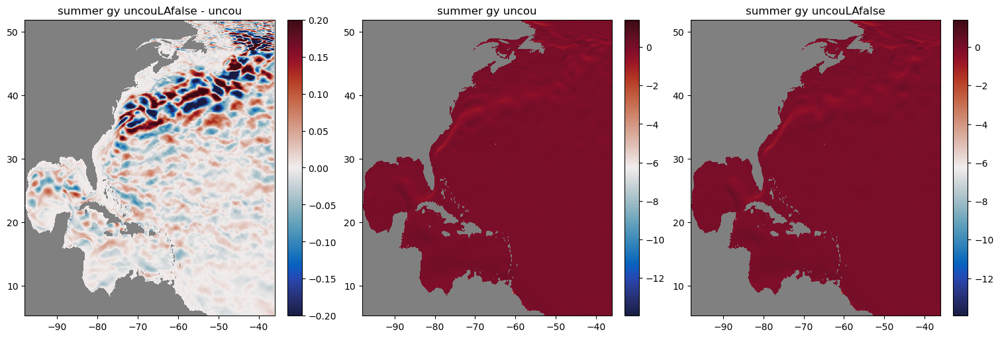

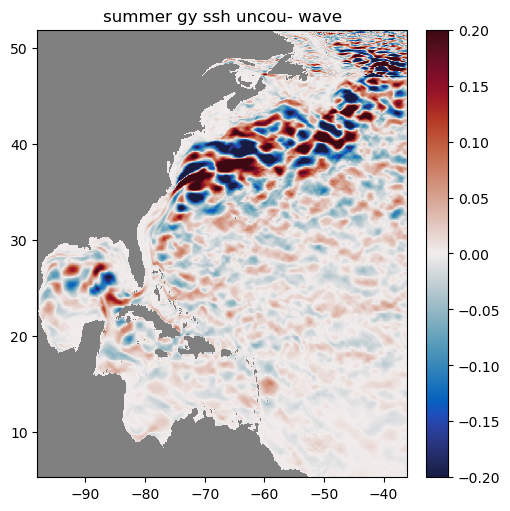

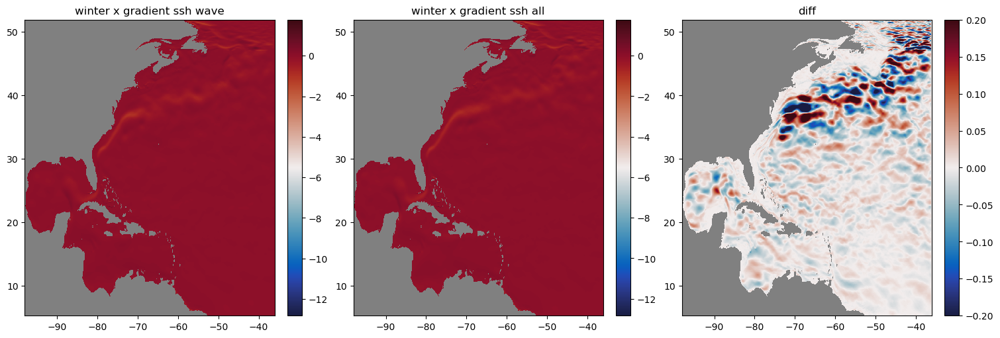

NameError: name 'gy' is not defined

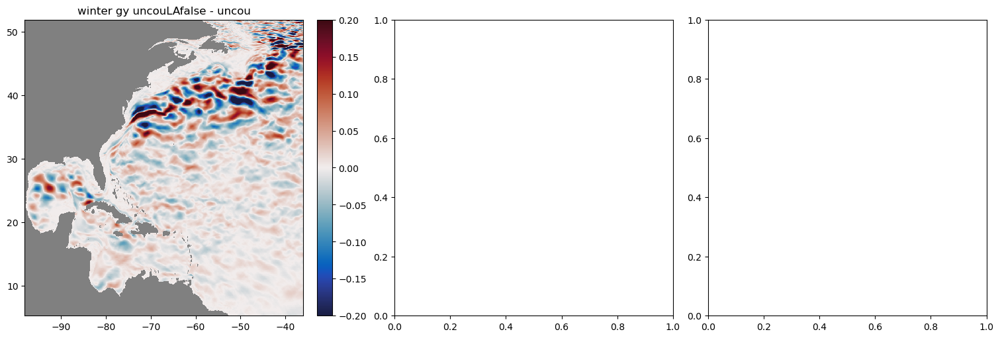

In [10]:
diff_gx_summer_all=gx_summer_all-gx_summer_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,gx_summer_wave , cmap=cmap, shading='auto')
axes[0].set_title('summer x gradient ssh wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_summer_all, cmap=cmap, shading='auto')
axes[1].set_title('summer x gradient ssh all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_gx_summer_all, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gx_summer_uncou=gx_summer_uncou-gx_summer_uncou_LAfalse

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, -diff_gx_summer_uncou , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('summer gx uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_summer_uncou, cmap=cmap, shading='auto')
axes[1].set_title('summer gx uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_summer_uncou_LAfalse, cmap=cmap, shading='auto')
axes[2].set_title('summer gx uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gx_summer_wave=gx_summer_uncou-gx_summer_wave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_gx_summer_wave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes.set_title('summer gx ssh uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()



diff_gx_winter_all=gx_winter_all-gx_winter_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,gx_winter_wave , cmap=cmap, shading='auto')
axes[0].set_title('winter x gradient ssh wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_winter_all, cmap=cmap, shading='auto')
axes[1].set_title('winter x gradient ssh all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_gx_winter_all, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gx_winter_uncou=gx_winter_uncou-gx_winter_uncou_LAfalse

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, -diff_gx_winter_uncou , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('winter gx uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gx_winter_uncou, cmap=cmap, shading='auto')
axes[1].set_title('winter gx uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gx_winter_uncou_LAfalse, cmap=cmap, shading='auto')
axes[2].set_title('winter gx uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gx_winter_wave=gx_winter_uncou-gx_winter_wave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_gx_winter_wave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes.set_title('winter gx ssh uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()


#-----gy
diff_gy_summer_all=gy_summer_all-gy_summer_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,gy_summer_wave , cmap=cmap, shading='auto')
axes[0].set_title('summer x gradient ssh wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_summer_all, cmap=cmap, shading='auto')
axes[1].set_title('summer x gradient ssh all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_gy_summer_all, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gy_summer_uncou=gy_summer_uncou-gy_summer_uncou_LAfalse

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, -diff_gy_summer_uncou , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('summer gy uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_summer_uncou, cmap=cmap, shading='auto')
axes[1].set_title('summer gy uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_summer_uncou_LAfalse, cmap=cmap, shading='auto')
axes[2].set_title('summer gy uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gy_summer_wave=gy_summer_uncou-gy_summer_wave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_gy_summer_wave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes.set_title('summer gy ssh uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()



diff_gy_winter_all=gy_winter_all-gy_winter_wave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,gy_winter_wave , cmap=cmap, shading='auto')
axes[0].set_title('winter x gradient ssh wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_winter_all, cmap=cmap, shading='auto')
axes[1].set_title('winter x gradient ssh all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_gy_winter_all, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gy_winter_uncou=gy_winter_uncou-gy_winter_uncou_LAfalse

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, -diff_gy_winter_uncou , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('winter gy uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, gy_winter_uncou-gy, cmap=cmap, shading='auto')
axes[1].set_title('winter gy uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, gy_winter_uncou_LAfalse, cmap=cmap, shading='auto')
axes[2].set_title('winter gy uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_gy_winter_wave=gy_winter_uncou-gy_winter_wave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_gy_winter_wave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes.set_title('winter gy ssh uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()

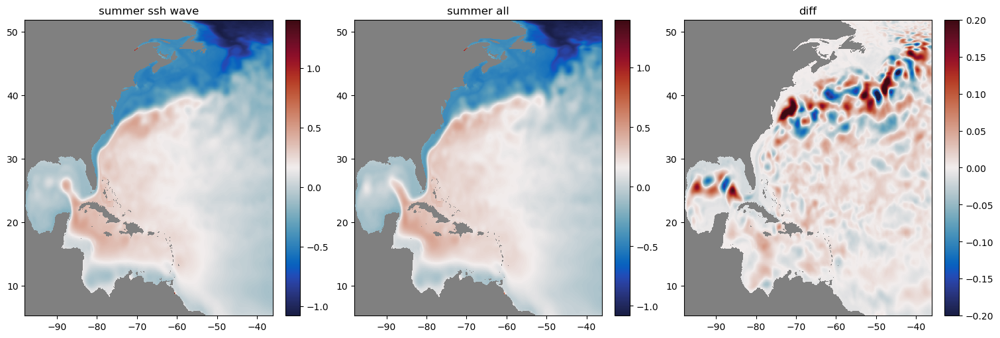

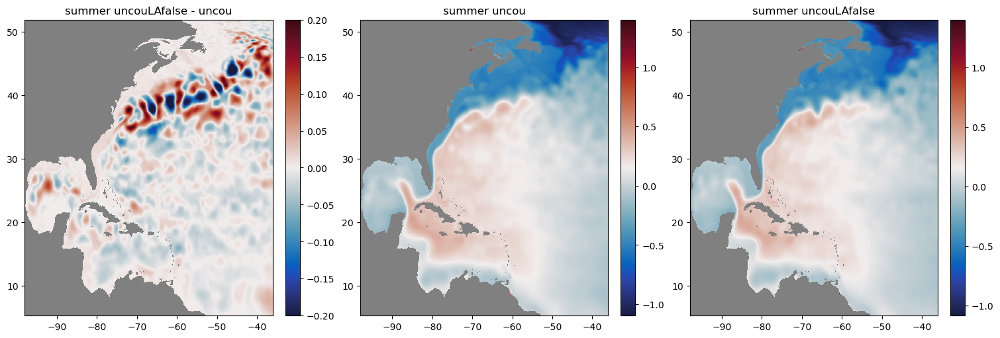

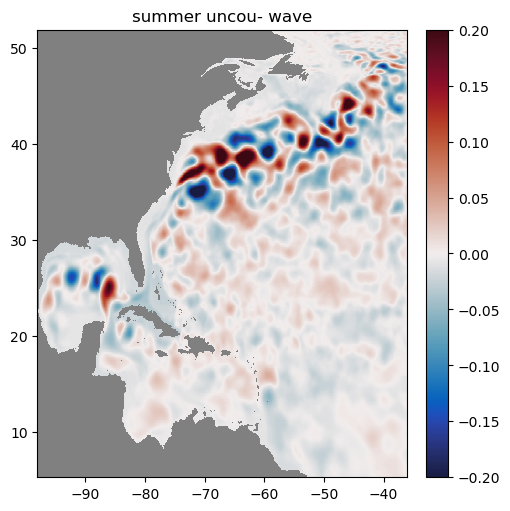

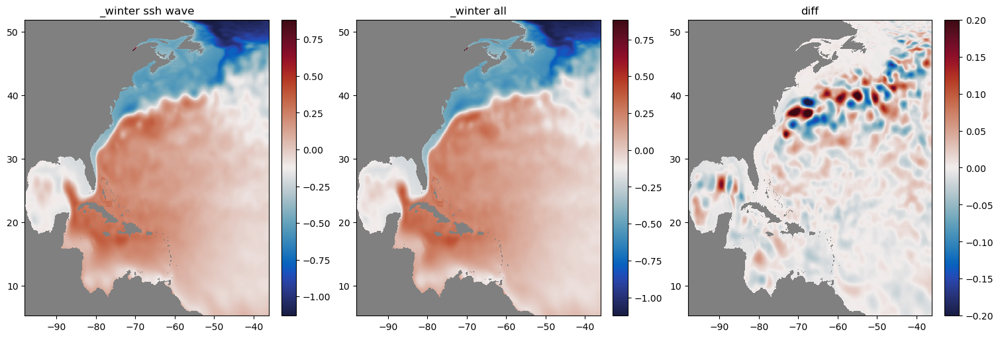

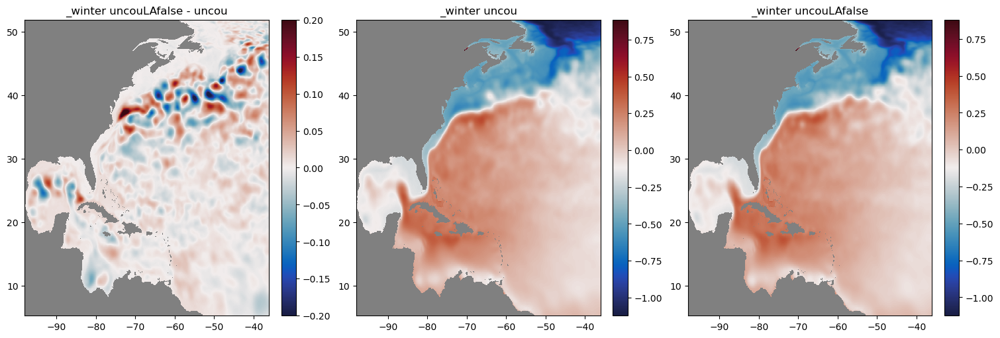

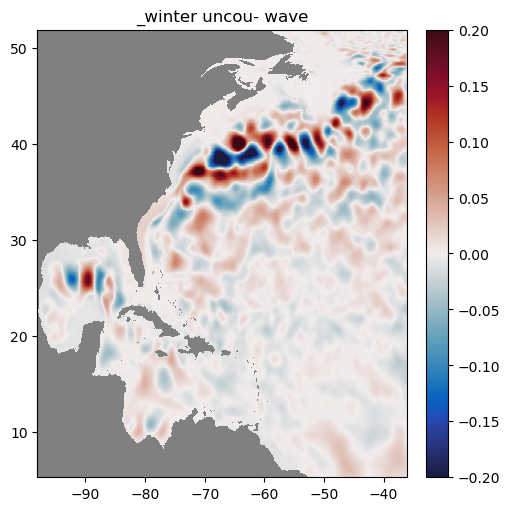

In [82]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,ssh_wave_summer_ave , cmap=cmap, shading='auto')
axes[0].set_title('summer ssh wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_all_summer_ave, cmap=cmap, shading='auto')
axes[1].set_title('summer all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssh_all_summer, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ssh_uncou_summer_ave=ssh_uncou_LAfalse_summer_ave-ssh_uncou_summer_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_uncou_summer_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('summer uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_summer_ave, cmap=cmap, shading='auto')
axes[1].set_title('summer uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_LAfalse_summer_ave, cmap=cmap, shading='auto')
axes[2].set_title('summer uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ssh_wave_summer_ave=ssh_uncou_summer_ave-ssh_wave_summer_ave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_ssh_wave_summer_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes.set_title('summer uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()


diff_ssh_all_winter= ssh_all_winter_ave - ssh_wave_winter_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,ssh_wave_winter_ave , cmap=cmap, shading='auto')
axes[0].set_title('_winter ssh wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_all_winter_ave, cmap=cmap, shading='auto')
axes[1].set_title('_winter all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssh_all_winter, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ssh_uncou_winter_ave=ssh_uncou_LAfalse_winter_ave-ssh_uncou_winter_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_uncou_winter_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('_winter uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_winter_ave, cmap=cmap, shading='auto')
axes[1].set_title('_winter uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_LAfalse_winter_ave, cmap=cmap, shading='auto')
axes[2].set_title('_winter uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_ssh_wave_winter_ave=ssh_uncou_winter_ave-ssh_wave_winter_ave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_ssh_wave_winter_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes.set_title('_winter uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()

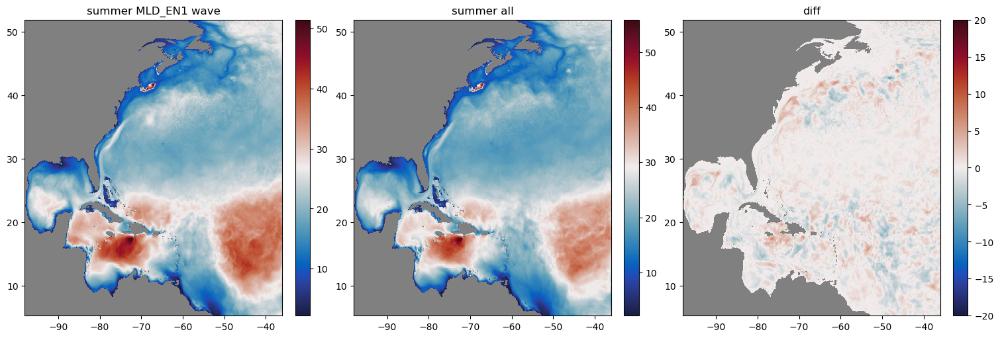

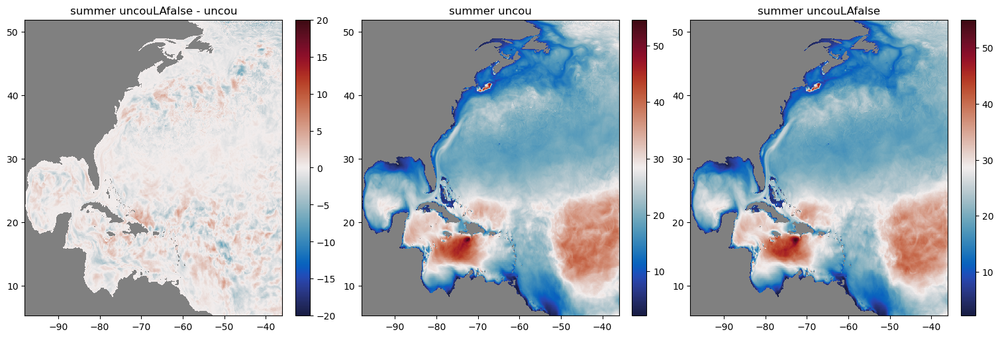

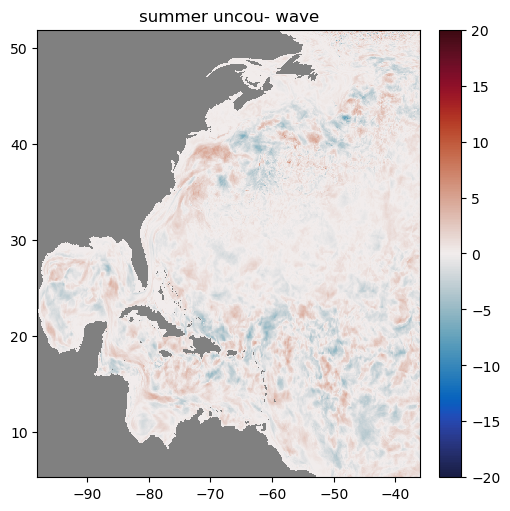

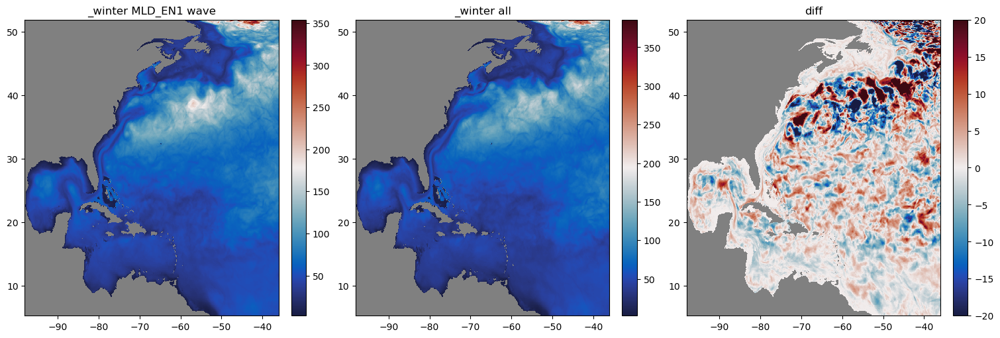

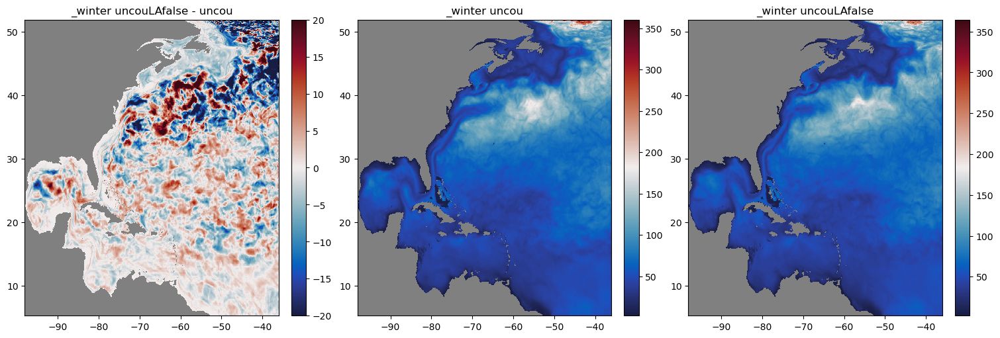

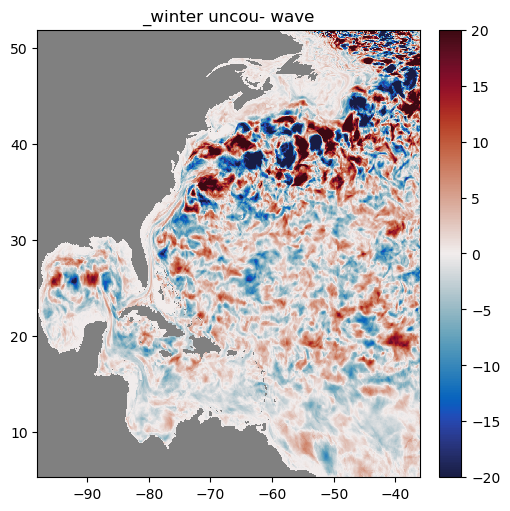

In [83]:
summer_datasets_uncou_MLD_EN1 = [
    seasonal_datasets["summer_uncou_1"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_2"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_11"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_22"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_111"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_222"].variables['MLD_EN1']
]
summer_datasets_uncou_LAfalse_MLD_EN1 = [
    seasonal_datasets["summer_uncou_LAfalse_1"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_LAfalse_2"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_LAfalse_11"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_LAfalse_22"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_LAfalse_111"].variables['MLD_EN1'],
    seasonal_datasets["summer_uncou_LAfalse_222"].variables['MLD_EN1']
]

winter_datasets_uncou_MLD_EN1 = [
    seasonal_datasets["winter_uncou_1"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_2"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_11"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_22"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_111"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_222"].variables['MLD_EN1']
]
winter_datasets_uncou_LAfalse_MLD_EN1 = [
    seasonal_datasets["winter_uncou_LAfalse_1"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_LAfalse_2"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_LAfalse_11"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_LAfalse_22"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_LAfalse_111"].variables['MLD_EN1'],
    seasonal_datasets["winter_uncou_LAfalse_222"].variables['MLD_EN1']
]

summer_datasets_wave_MLD_EN1 = [
    seasonal_datasets_wave["summer_wave_1"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_3"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_4"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_6"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_11"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_33"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_44"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_66"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_111"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_222"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_333"].variables['MLD_EN1'],
    seasonal_datasets_wave["summer_wave_444"].variables['MLD_EN1']
]

winter_datasets_wave_MLD_EN1 = [
    seasonal_datasets_wave["winter_wave_1"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_3"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_4"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_6"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_11"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_33"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_44"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_66"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_111"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_222"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_333"].variables['MLD_EN1'],
    seasonal_datasets_wave["winter_wave_444"].variables['MLD_EN1']
]



summer_datasets_all_MLD_EN1 = [
    seasonal_datasets_all["summer_all_1"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_3"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_4"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_6"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_11"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_33"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_44"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_66"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_111"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_222"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_333"].variables['MLD_EN1'],
    seasonal_datasets_all["summer_all_444"].variables['MLD_EN1']
]
winter_datasets_all_MLD_EN1 = [
    seasonal_datasets_all["winter_all_1"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_3"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_4"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_6"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_11"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_33"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_44"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_66"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_111"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_222"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_333"].variables['MLD_EN1'],
    seasonal_datasets_all["winter_all_444"].variables['MLD_EN1']
]
# Combine along time dimension

def filter_non_empty(datasets):
    return [ds for ds in datasets if ds is not None and ds.time.size > 0]
    
winter_datasets_wave_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in winter_datasets_wave_MLD_EN1
]
winter_datasets_wave_MLD_EN1_da = filter_non_empty(winter_datasets_wave_MLD_EN1_da)
MLD_EN1_wave_winter= xarray.concat(winter_datasets_wave_MLD_EN1_da, dim="time")
summer_datasets_wave_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in summer_datasets_wave_MLD_EN1
]
summer_datasets_wave_MLD_EN1_da = filter_non_empty(summer_datasets_wave_MLD_EN1_da)
MLD_EN1_wave_summer= xarray.concat(summer_datasets_wave_MLD_EN1_da, dim="time")


winter_datasets_all_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in winter_datasets_all_MLD_EN1
]
winter_datasets_all_MLD_EN1_da = filter_non_empty(winter_datasets_all_MLD_EN1_da)
MLD_EN1_all_winter= xarray.concat(winter_datasets_all_MLD_EN1_da, dim="time")

summer_datasets_all_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in summer_datasets_all_MLD_EN1
]
summer_datasets_all_MLD_EN1_da = filter_non_empty(summer_datasets_all_MLD_EN1_da)
MLD_EN1_all_summer= xarray.concat(summer_datasets_all_MLD_EN1_da, dim="time")


winter_datasets_uncou_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in winter_datasets_uncou_MLD_EN1
]
winter_datasets_uncou_MLD_EN1_da = filter_non_empty(winter_datasets_uncou_MLD_EN1_da)
MLD_EN1_uncou_winter= xarray.concat(winter_datasets_uncou_MLD_EN1_da, dim="time")

summer_datasets_uncou_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in summer_datasets_uncou_MLD_EN1
]
summer_datasets_uncou_MLD_EN1_da = filter_non_empty(summer_datasets_uncou_MLD_EN1_da)
MLD_EN1_uncou_summer= xarray.concat(summer_datasets_uncou_MLD_EN1_da, dim="time")


winter_datasets_uncou_LAfalse_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in winter_datasets_uncou_LAfalse_MLD_EN1
]
winter_datasets_uncou_LAfalse_MLD_EN1_da = filter_non_empty(winter_datasets_uncou_LAfalse_MLD_EN1_da)
MLD_EN1_uncou_LAfalse_winter= xarray.concat(winter_datasets_uncou_LAfalse_MLD_EN1_da, dim="time")

summer_datasets_uncou_LAfalse_MLD_EN1_da = [
    xarray.DataArray(var, dims=["time", "yh", "xh"]) for var in summer_datasets_uncou_LAfalse_MLD_EN1
]
summer_datasets_uncou_LAfalse_MLD_EN1_da = filter_non_empty(summer_datasets_uncou_LAfalse_MLD_EN1_da)
MLD_EN1_uncou_LAfalse_summer= xarray.concat(summer_datasets_uncou_LAfalse_MLD_EN1_da, dim="time")


MLD_EN1_all_summer_ave=MLD_EN1_all_summer.mean('time')
MLD_EN1_all_winter_ave=MLD_EN1_all_winter.mean('time')
MLD_EN1_wave_summer_ave=MLD_EN1_wave_summer.mean('time')
MLD_EN1_wave_winter_ave=MLD_EN1_wave_winter.mean('time')
MLD_EN1_uncou_summer_ave=MLD_EN1_uncou_summer.mean('time')
MLD_EN1_uncou_winter_ave=MLD_EN1_uncou_winter.mean('time')
MLD_EN1_uncou_LAfalse_summer_ave=MLD_EN1_uncou_LAfalse_summer.mean('time')
MLD_EN1_uncou_LAfalse_winter_ave=MLD_EN1_uncou_LAfalse_winter.mean('time')


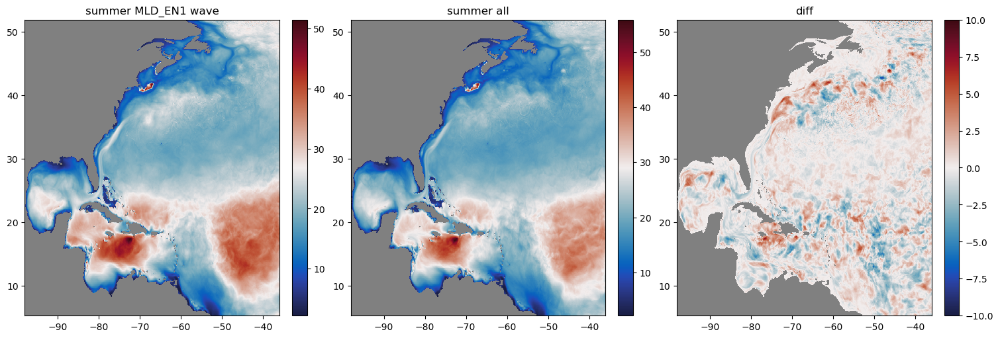

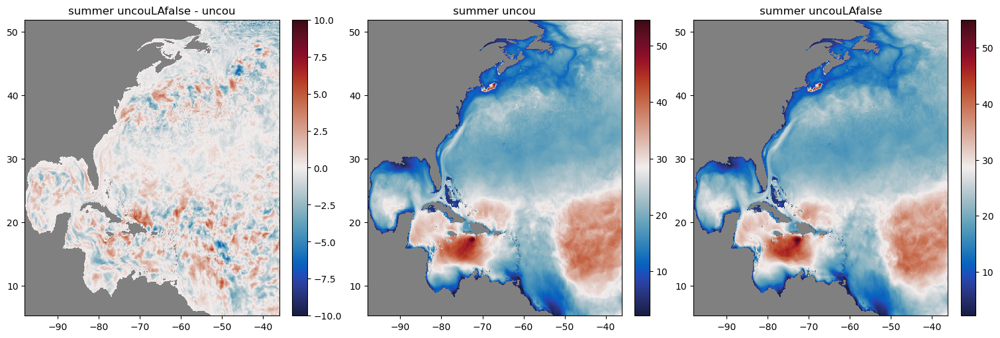

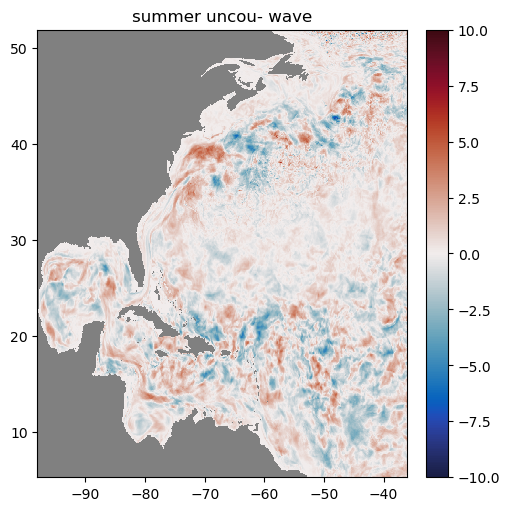

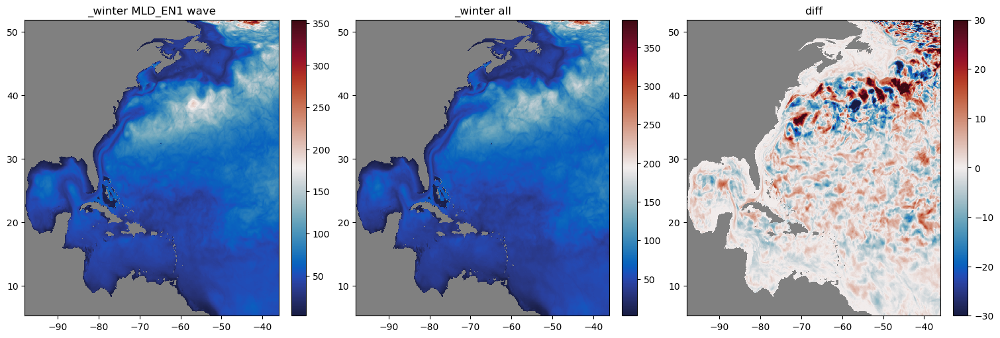

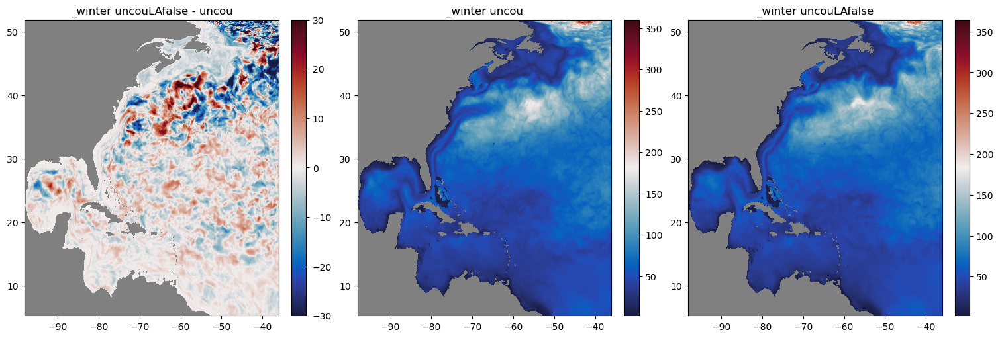

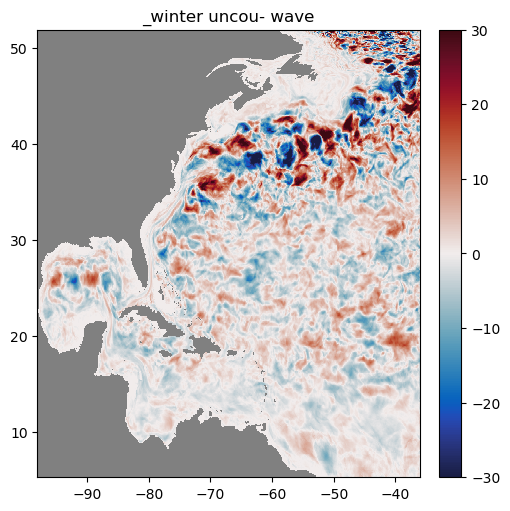

In [84]:
diff_MLD_EN1_all_summer= MLD_EN1_all_summer_ave - MLD_EN1_wave_summer_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,MLD_EN1_wave_summer_ave , cmap=cmap, shading='auto')
axes[0].set_title('summer MLD_EN1 wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_all_summer_ave, cmap=cmap, shading='auto')
axes[1].set_title('summer all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_all_summer, cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_MLD_EN1_uncou_summer_ave=MLD_EN1_uncou_LAfalse_summer_ave-MLD_EN1_uncou_summer_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_summer_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes[0].set_title('summer uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_summer_ave, cmap=cmap, shading='auto')
axes[1].set_title('summer uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_LAfalse_summer_ave, cmap=cmap, shading='auto')
axes[2].set_title('summer uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_MLD_EN1_wave_summer_ave=MLD_EN1_uncou_summer_ave-MLD_EN1_wave_summer_ave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_wave_summer_ave , cmap=cmap, shading='auto',vmin=-10,vmax=10)
axes.set_title('summer uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()


diff_MLD_EN1_all_winter= MLD_EN1_all_winter_ave - MLD_EN1_wave_winter_ave
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,MLD_EN1_wave_winter_ave , cmap=cmap, shading='auto')
axes[0].set_title('_winter MLD_EN1 wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_all_winter_ave, cmap=cmap, shading='auto')
axes[1].set_title('_winter all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_all_winter, cmap=cmap, shading='auto',vmin=-30,vmax=30)
axes[2].set_title('diff')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_MLD_EN1_uncou_winter_ave=MLD_EN1_uncou_LAfalse_winter_ave-MLD_EN1_uncou_winter_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_winter_ave , cmap=cmap, shading='auto',vmin=-30,vmax=30)
axes[0].set_title('_winter uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_winter_ave, cmap=cmap, shading='auto')
axes[1].set_title('_winter uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_LAfalse_winter_ave, cmap=cmap, shading='auto')
axes[2].set_title('_winter uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

diff_MLD_EN1_wave_winter_ave=MLD_EN1_uncou_winter_ave-MLD_EN1_wave_winter_ave
fig, axes = plt.subplots(1, 1, figsize=(5, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes.pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_wave_winter_ave , cmap=cmap, shading='auto',vmin=-30,vmax=30)
axes.set_title('_winter uncou- wave')
plt.colorbar(mesh1, ax=axes)  # Add colorbar for the first plot
plt.show()

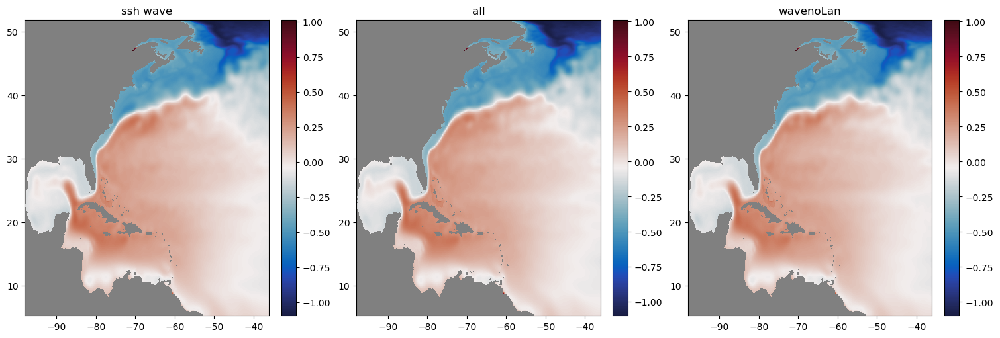

NameError: name 'diff_ssh_all_ave' is not defined

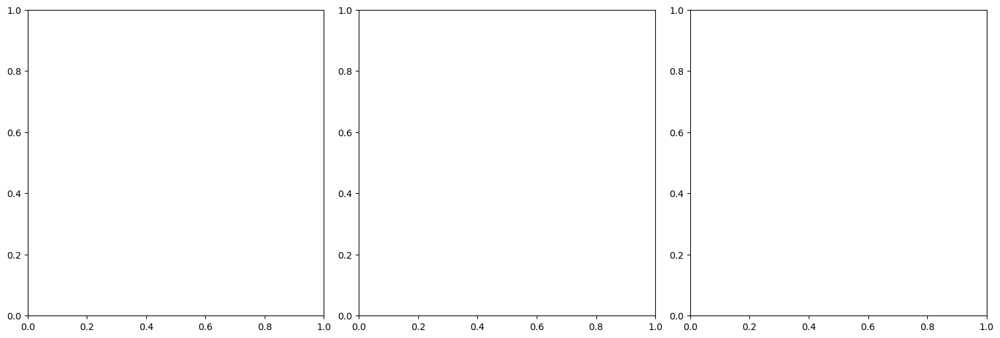

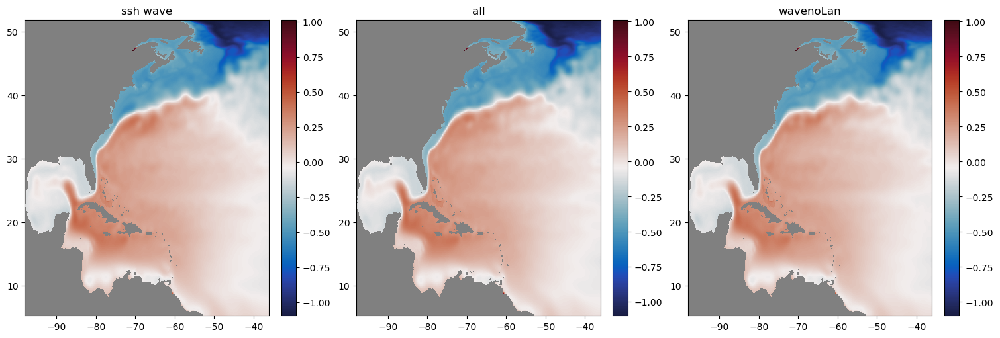

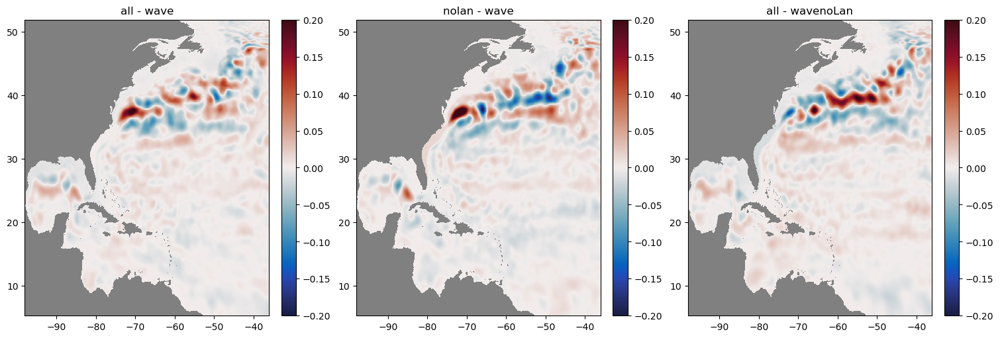

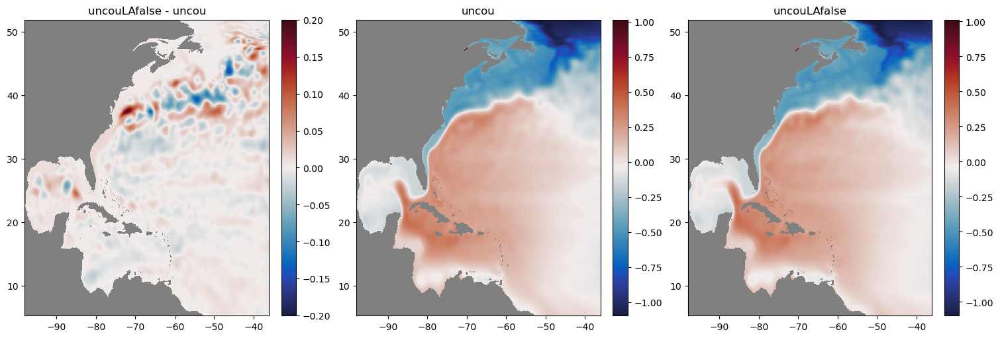

In [16]:

diff_ssh_all_ave=ssh_all_ave - ssh_wave_ave

diff_ssh_uncou_ave=ssh_uncou_LAfalse_ave - ssh_uncou_ave

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,ssh_wave_ave , cmap=cmap, shading='auto')
axes[0].set_title('ssh wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_all_ave, cmap=cmap, shading='auto')
axes[1].set_title('all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_nolan_ave, cmap=cmap, shading='auto')
axes[2].set_title('wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,diff_ssh_all_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('all - wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssh_nolan_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[1].set_title('nolan - wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssh_allnolan_ave, cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[2].set_title('all - wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ssh_uncou_ave , cmap=cmap, shading='auto',vmin=-0.2,vmax=0.2)
axes[0].set_title('uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssh_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

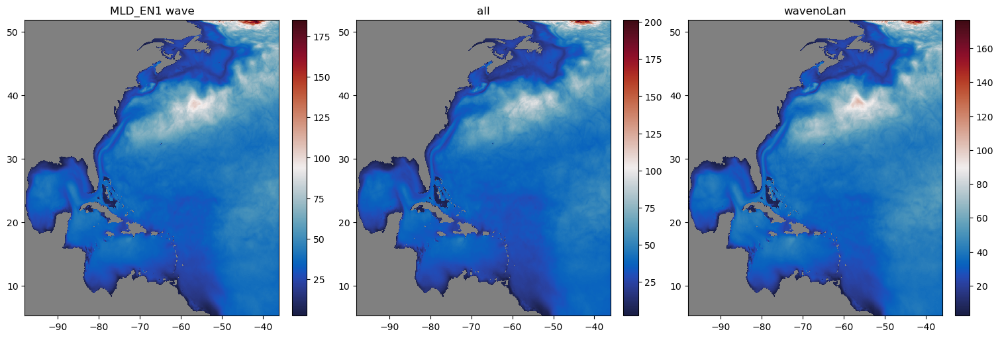

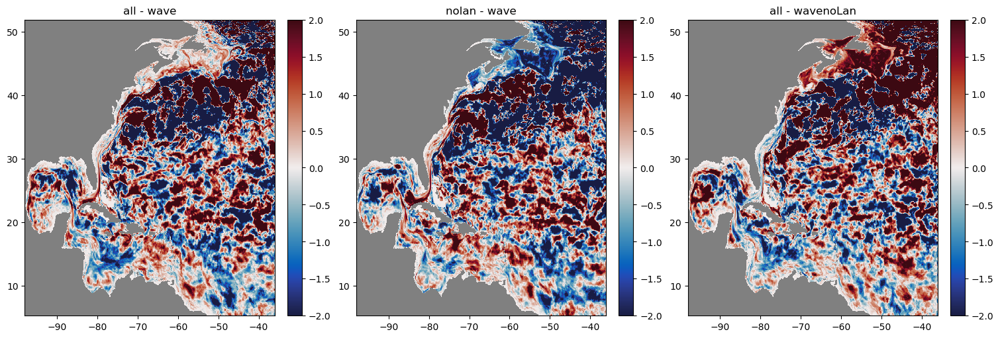

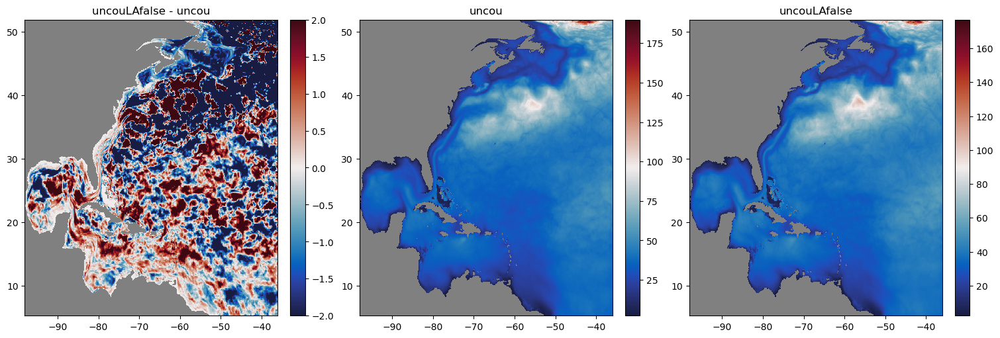

In [17]:
MLD_EN1_uncou_1=ocean_daily_uncou_1.variables['MLD_EN1']
MLD_EN1_uncou_2=ocean_daily_uncou_2.variables['MLD_EN1']
MLD_EN1_uncou_11=ocean_daily_uncou_11.variables['MLD_EN1']
MLD_EN1_uncou_22=ocean_daily_uncou_22.variables['MLD_EN1']
MLD_EN1_uncou_111=ocean_daily_uncou_111.variables['MLD_EN1']
MLD_EN1_uncou_222=ocean_daily_uncou_222.variables['MLD_EN1']

xr_MLD_EN1_uncou_1= xarray.DataArray(MLD_EN1_uncou_1, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_2= xarray.DataArray(MLD_EN1_uncou_2, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_11= xarray.DataArray(MLD_EN1_uncou_11, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_22= xarray.DataArray(MLD_EN1_uncou_22, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_111= xarray.DataArray(MLD_EN1_uncou_111, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_222= xarray.DataArray(MLD_EN1_uncou_222, dims=["time", "yh", "xh"])
MLD_EN1_uncou=xarray.concat([xr_MLD_EN1_uncou_1,xr_MLD_EN1_uncou_2,xr_MLD_EN1_uncou_11,xr_MLD_EN1_uncou_22,xr_MLD_EN1_uncou_111,xr_MLD_EN1_uncou_222], dim='time')
MLD_EN1_uncou_ave=MLD_EN1_uncou.mean('time')


MLD_EN1_uncou_LAfalse_1=ocean_daily_uncou_LAfalse_1.variables['MLD_EN1']
MLD_EN1_uncou_LAfalse_2=ocean_daily_uncou_LAfalse_2.variables['MLD_EN1']
MLD_EN1_uncou_LAfalse_11=ocean_daily_uncou_LAfalse_11.variables['MLD_EN1']
MLD_EN1_uncou_LAfalse_22=ocean_daily_uncou_LAfalse_22.variables['MLD_EN1']
MLD_EN1_uncou_LAfalse_111=ocean_daily_uncou_LAfalse_111.variables['MLD_EN1']
MLD_EN1_uncou_LAfalse_222=ocean_daily_uncou_LAfalse_222.variables['MLD_EN1']
xr_MLD_EN1_uncou_LAfalse_1= xarray.DataArray(MLD_EN1_uncou_LAfalse_1, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_LAfalse_2= xarray.DataArray(MLD_EN1_uncou_LAfalse_2, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_LAfalse_11= xarray.DataArray(MLD_EN1_uncou_LAfalse_11, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_LAfalse_22= xarray.DataArray(MLD_EN1_uncou_LAfalse_22, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_LAfalse_111= xarray.DataArray(MLD_EN1_uncou_LAfalse_111, dims=["time", "yh", "xh"])
xr_MLD_EN1_uncou_LAfalse_222= xarray.DataArray(MLD_EN1_uncou_LAfalse_222, dims=["time", "yh", "xh"])
MLD_EN1_uncou_LAfalse=xarray.concat([xr_MLD_EN1_uncou_LAfalse_1,xr_MLD_EN1_uncou_LAfalse_2,xr_MLD_EN1_uncou_LAfalse_11,xr_MLD_EN1_uncou_LAfalse_22,xr_MLD_EN1_uncou_LAfalse_111,xr_MLD_EN1_uncou_LAfalse_222], dim='time')
MLD_EN1_uncou_LAfalse_ave=MLD_EN1_uncou_LAfalse.mean('time')



MLD_EN1_wave_1=ocean_daily_wave_1.variables['MLD_EN1']
MLD_EN1_wave_2=ocean_daily_wave_2.variables['MLD_EN1']
MLD_EN1_wave_3=ocean_daily_wave_3.variables['MLD_EN1']
MLD_EN1_wave_4=ocean_daily_wave_4.variables['MLD_EN1']
MLD_EN1_wave_5=ocean_daily_wave_5.variables['MLD_EN1']
MLD_EN1_wave_6=ocean_daily_wave_6.variables['MLD_EN1']
MLD_EN1_wave_11=ocean_daily_wave_11.variables['MLD_EN1']
MLD_EN1_wave_22=ocean_daily_wave_22.variables['MLD_EN1']
MLD_EN1_wave_33=ocean_daily_wave_33.variables['MLD_EN1']
MLD_EN1_wave_44=ocean_daily_wave_44.variables['MLD_EN1']
MLD_EN1_wave_55=ocean_daily_wave_55.variables['MLD_EN1']
MLD_EN1_wave_66=ocean_daily_wave_66.variables['MLD_EN1']
MLD_EN1_wave_111=ocean_daily_wave_111.variables['MLD_EN1']
MLD_EN1_wave_222=ocean_daily_wave_222.variables['MLD_EN1']
MLD_EN1_wave_333=ocean_daily_wave_333.variables['MLD_EN1']
MLD_EN1_wave_444=ocean_daily_wave_444.variables['MLD_EN1']
xr_MLD_EN1_wave_1= xarray.DataArray(MLD_EN1_wave_1, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_2= xarray.DataArray(MLD_EN1_wave_2, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_3= xarray.DataArray(MLD_EN1_wave_3, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_4= xarray.DataArray(MLD_EN1_wave_4, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_5= xarray.DataArray(MLD_EN1_wave_5, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_6= xarray.DataArray(MLD_EN1_wave_6, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_11= xarray.DataArray(MLD_EN1_wave_11, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_22= xarray.DataArray(MLD_EN1_wave_22, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_33= xarray.DataArray(MLD_EN1_wave_33, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_44= xarray.DataArray(MLD_EN1_wave_44, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_55= xarray.DataArray(MLD_EN1_wave_55, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_66= xarray.DataArray(MLD_EN1_wave_66, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_111= xarray.DataArray(MLD_EN1_wave_111, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_222= xarray.DataArray(MLD_EN1_wave_222, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_333= xarray.DataArray(MLD_EN1_wave_333, dims=["time", "yh", "xh"])
xr_MLD_EN1_wave_444= xarray.DataArray(MLD_EN1_wave_444, dims=["time", "yh", "xh"])
MLD_EN1_wave=xarray.concat([xr_MLD_EN1_wave_1, xr_MLD_EN1_wave_2, xr_MLD_EN1_wave_3, xr_MLD_EN1_wave_4, xr_MLD_EN1_wave_5, xr_MLD_EN1_wave_6,xr_MLD_EN1_wave_11, xr_MLD_EN1_wave_22, xr_MLD_EN1_wave_33, xr_MLD_EN1_wave_44, xr_MLD_EN1_wave_55, xr_MLD_EN1_wave_66,xr_MLD_EN1_wave_111, xr_MLD_EN1_wave_222, xr_MLD_EN1_wave_333, xr_MLD_EN1_wave_444], dim='time')
MLD_EN1_wave_ave=MLD_EN1_wave.mean('time')


MLD_EN1_all_1=ocean_daily_all_1.variables['MLD_EN1']
MLD_EN1_all_2=ocean_daily_all_2.variables['MLD_EN1']
MLD_EN1_all_3=ocean_daily_all_3.variables['MLD_EN1']
MLD_EN1_all_4=ocean_daily_all_4.variables['MLD_EN1']
MLD_EN1_all_5=ocean_daily_all_5.variables['MLD_EN1']
MLD_EN1_all_6=ocean_daily_all_6.variables['MLD_EN1']
MLD_EN1_all_11=ocean_daily_all_11.variables['MLD_EN1']
MLD_EN1_all_22=ocean_daily_all_22.variables['MLD_EN1']
MLD_EN1_all_33=ocean_daily_all_33.variables['MLD_EN1']
MLD_EN1_all_44=ocean_daily_all_44.variables['MLD_EN1']
MLD_EN1_all_55=ocean_daily_all_55.variables['MLD_EN1']
MLD_EN1_all_66=ocean_daily_all_66.variables['MLD_EN1']
MLD_EN1_all_111=ocean_daily_all_111.variables['MLD_EN1']
MLD_EN1_all_222=ocean_daily_all_222.variables['MLD_EN1']
MLD_EN1_all_333=ocean_daily_all_333.variables['MLD_EN1']
MLD_EN1_all_444=ocean_daily_all_444.variables['MLD_EN1']
xr_MLD_EN1_all_1= xarray.DataArray(MLD_EN1_all_1, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_2= xarray.DataArray(MLD_EN1_all_2, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_3= xarray.DataArray(MLD_EN1_all_3, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_4= xarray.DataArray(MLD_EN1_all_4, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_5= xarray.DataArray(MLD_EN1_all_5, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_6= xarray.DataArray(MLD_EN1_all_6, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_11= xarray.DataArray(MLD_EN1_all_11, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_22= xarray.DataArray(MLD_EN1_all_22, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_33= xarray.DataArray(MLD_EN1_all_33, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_44= xarray.DataArray(MLD_EN1_all_44, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_55= xarray.DataArray(MLD_EN1_all_55, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_66= xarray.DataArray(MLD_EN1_all_66, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_111= xarray.DataArray(MLD_EN1_all_111, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_222= xarray.DataArray(MLD_EN1_all_222, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_333= xarray.DataArray(MLD_EN1_all_333, dims=["time", "yh", "xh"])
xr_MLD_EN1_all_444= xarray.DataArray(MLD_EN1_all_444, dims=["time", "yh", "xh"])
MLD_EN1_all=xarray.concat([xr_MLD_EN1_all_1, xr_MLD_EN1_all_2, xr_MLD_EN1_all_3, xr_MLD_EN1_all_4, xr_MLD_EN1_all_5, xr_MLD_EN1_all_6,xr_MLD_EN1_all_11, xr_MLD_EN1_all_22, xr_MLD_EN1_all_33, xr_MLD_EN1_all_44, xr_MLD_EN1_all_55, xr_MLD_EN1_all_66,xr_MLD_EN1_all_111, xr_MLD_EN1_all_222, xr_MLD_EN1_all_333, xr_MLD_EN1_all_444], dim='time')
MLD_EN1_all_ave=MLD_EN1_all.mean('time')





diff_MLD_EN1_all_ave=MLD_EN1_all_ave - MLD_EN1_wave_ave
diff_MLD_EN1_uncou_ave=MLD_EN1_uncou_LAfalse_ave - MLD_EN1_uncou_ave




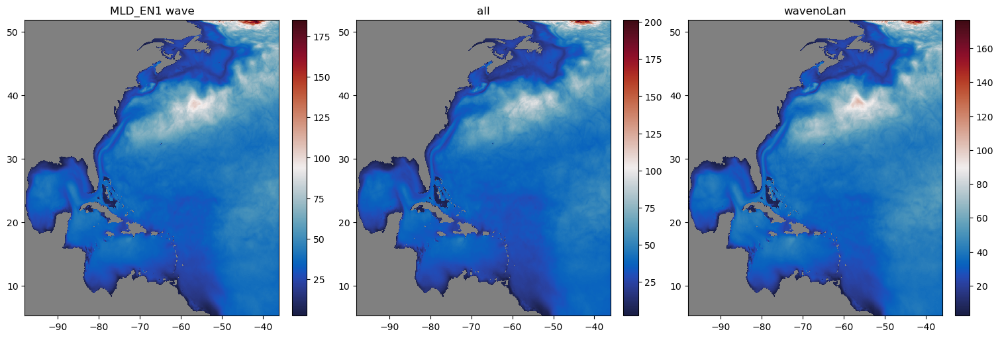

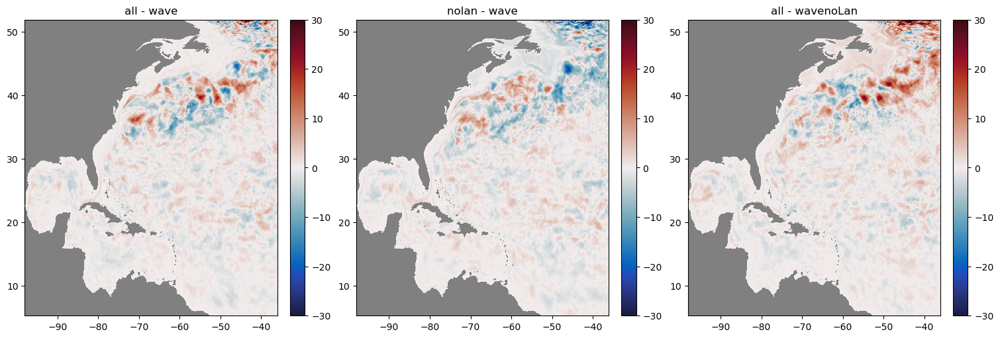

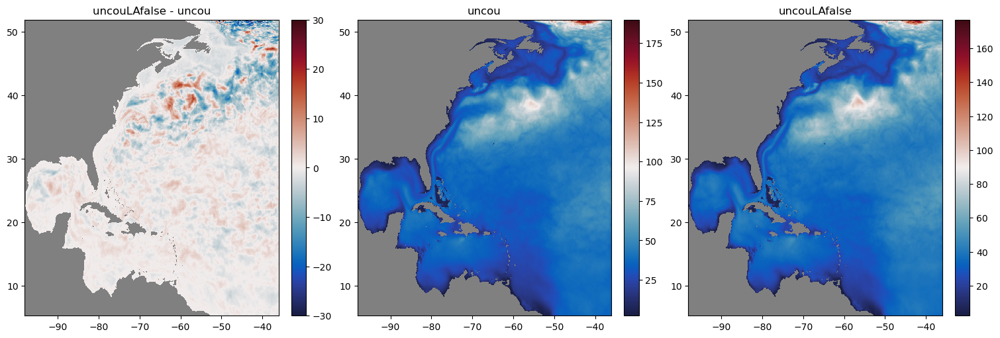

In [22]:

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,MLD_EN1_wave_ave , cmap=cmap, shading='auto')
axes[0].set_title('MLD_EN1 wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_all_ave, cmap=cmap, shading='auto')
axes[1].set_title('all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_nolan_ave, cmap=cmap, shading='auto')
axes[2].set_title('wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,diff_MLD_EN1_all_ave , cmap=cmap, shading='auto',vmin=-30,vmax=30)
axes[0].set_title('all - wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_nolan_ave, cmap=cmap, shading='auto',vmin=-30,vmax=30)
axes[1].set_title('nolan - wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_allnolan_ave, cmap=cmap, shading='auto',vmin=-30,vmax=30)
axes[2].set_title('all - wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_MLD_EN1_uncou_ave , cmap=cmap, shading='auto',vmin=-30,vmax=30)
axes[0].set_title('uncouLAfalse - uncou')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('uncou')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, MLD_EN1_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('uncouLAfalse')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

In [24]:

ssx_wave_1=ocean_daily_wave_1.variables['surface_stokes_x']
ssx_wave_2=ocean_daily_wave_2.variables['surface_stokes_x']
ssx_wave_3=ocean_daily_wave_3.variables['surface_stokes_x']
ssx_wave_4=ocean_daily_wave_4.variables['surface_stokes_x']
ssx_wave_5=ocean_daily_wave_5.variables['surface_stokes_x']
ssx_wave_6=ocean_daily_wave_6.variables['surface_stokes_x']
ssx_wave_11=ocean_daily_wave_11.variables['surface_stokes_x']
ssx_wave_22=ocean_daily_wave_22.variables['surface_stokes_x']
ssx_wave_33=ocean_daily_wave_33.variables['surface_stokes_x']
ssx_wave_44=ocean_daily_wave_44.variables['surface_stokes_x']
ssx_wave_55=ocean_daily_wave_55.variables['surface_stokes_x']
ssx_wave_66=ocean_daily_wave_66.variables['surface_stokes_x']
ssx_wave_111=ocean_daily_wave_111.variables['surface_stokes_x']
ssx_wave_222=ocean_daily_wave_222.variables['surface_stokes_x']
ssx_wave_333=ocean_daily_wave_333.variables['surface_stokes_x']
ssx_wave_444=ocean_daily_wave_444.variables['surface_stokes_x']
xr_ssx_wave_1= xarray.DataArray(ssx_wave_1, dims=["time", "yh", "xh"])
xr_ssx_wave_2= xarray.DataArray(ssx_wave_2, dims=["time", "yh", "xh"])
xr_ssx_wave_3= xarray.DataArray(ssx_wave_3, dims=["time", "yh", "xh"])
xr_ssx_wave_4= xarray.DataArray(ssx_wave_4, dims=["time", "yh", "xh"])
xr_ssx_wave_5= xarray.DataArray(ssx_wave_5, dims=["time", "yh", "xh"])
xr_ssx_wave_6= xarray.DataArray(ssx_wave_6, dims=["time", "yh", "xh"])
xr_ssx_wave_11= xarray.DataArray(ssx_wave_11, dims=["time", "yh", "xh"])
xr_ssx_wave_22= xarray.DataArray(ssx_wave_22, dims=["time", "yh", "xh"])
xr_ssx_wave_33= xarray.DataArray(ssx_wave_33, dims=["time", "yh", "xh"])
xr_ssx_wave_44= xarray.DataArray(ssx_wave_44, dims=["time", "yh", "xh"])
xr_ssx_wave_55= xarray.DataArray(ssx_wave_55, dims=["time", "yh", "xh"])
xr_ssx_wave_66= xarray.DataArray(ssx_wave_66, dims=["time", "yh", "xh"])
xr_ssx_wave_111= xarray.DataArray(ssx_wave_111, dims=["time", "yh", "xh"])
xr_ssx_wave_222= xarray.DataArray(ssx_wave_222, dims=["time", "yh", "xh"])
xr_ssx_wave_333= xarray.DataArray(ssx_wave_333, dims=["time", "yh", "xh"])
xr_ssx_wave_444= xarray.DataArray(ssx_wave_444, dims=["time", "yh", "xh"])
ssx_wave=xarray.concat([xr_ssx_wave_1, xr_ssx_wave_2, xr_ssx_wave_3, xr_ssx_wave_4, xr_ssx_wave_5, xr_ssx_wave_6,xr_ssx_wave_11, xr_ssx_wave_22, xr_ssx_wave_33, xr_ssx_wave_44, xr_ssx_wave_55, xr_ssx_wave_66,xr_ssx_wave_111, xr_ssx_wave_222, xr_ssx_wave_333, xr_ssx_wave_444], dim='time')
ssx_wave_ave=ssx_wave.mean('time')[:,1:]


ssx_all_1=ocean_daily_all_1.variables['surface_stokes_x']
ssx_all_2=ocean_daily_all_2.variables['surface_stokes_x']
ssx_all_3=ocean_daily_all_3.variables['surface_stokes_x']
ssx_all_4=ocean_daily_all_4.variables['surface_stokes_x']
ssx_all_5=ocean_daily_all_5.variables['surface_stokes_x']
ssx_all_6=ocean_daily_all_6.variables['surface_stokes_x']
ssx_all_11=ocean_daily_all_11.variables['surface_stokes_x']
ssx_all_22=ocean_daily_all_22.variables['surface_stokes_x']
ssx_all_33=ocean_daily_all_33.variables['surface_stokes_x']
ssx_all_44=ocean_daily_all_44.variables['surface_stokes_x']
ssx_all_55=ocean_daily_all_55.variables['surface_stokes_x']
ssx_all_66=ocean_daily_all_66.variables['surface_stokes_x']
ssx_all_111=ocean_daily_all_111.variables['surface_stokes_x']
ssx_all_222=ocean_daily_all_222.variables['surface_stokes_x']
ssx_all_333=ocean_daily_all_333.variables['surface_stokes_x']
ssx_all_444=ocean_daily_all_444.variables['surface_stokes_x']
xr_ssx_all_1= xarray.DataArray(ssx_all_1, dims=["time", "yh", "xh"])
xr_ssx_all_2= xarray.DataArray(ssx_all_2, dims=["time", "yh", "xh"])
xr_ssx_all_3= xarray.DataArray(ssx_all_3, dims=["time", "yh", "xh"])
xr_ssx_all_4= xarray.DataArray(ssx_all_4, dims=["time", "yh", "xh"])
xr_ssx_all_5= xarray.DataArray(ssx_all_5, dims=["time", "yh", "xh"])
xr_ssx_all_6= xarray.DataArray(ssx_all_6, dims=["time", "yh", "xh"])
xr_ssx_all_11= xarray.DataArray(ssx_all_11, dims=["time", "yh", "xh"])
xr_ssx_all_22= xarray.DataArray(ssx_all_22, dims=["time", "yh", "xh"])
xr_ssx_all_33= xarray.DataArray(ssx_all_33, dims=["time", "yh", "xh"])
xr_ssx_all_44= xarray.DataArray(ssx_all_44, dims=["time", "yh", "xh"])
xr_ssx_all_55= xarray.DataArray(ssx_all_55, dims=["time", "yh", "xh"])
xr_ssx_all_66= xarray.DataArray(ssx_all_66, dims=["time", "yh", "xh"])
xr_ssx_all_111= xarray.DataArray(ssx_all_111, dims=["time", "yh", "xh"])
xr_ssx_all_222= xarray.DataArray(ssx_all_222, dims=["time", "yh", "xh"])
xr_ssx_all_333= xarray.DataArray(ssx_all_333, dims=["time", "yh", "xh"])
xr_ssx_all_444= xarray.DataArray(ssx_all_444, dims=["time", "yh", "xh"])
ssx_all=xarray.concat([xr_ssx_all_1, xr_ssx_all_2, xr_ssx_all_3, xr_ssx_all_4, xr_ssx_all_5, xr_ssx_all_6,xr_ssx_all_11, xr_ssx_all_22, xr_ssx_all_33, xr_ssx_all_44, xr_ssx_all_55, xr_ssx_all_66,xr_ssx_all_111, xr_ssx_all_222, xr_ssx_all_333, xr_ssx_all_444], dim='time')
ssx_all_ave=ssx_all.mean('time')[:,1:]





NameError: name 'ssx_uncou_LAfalse_ave' is not defined

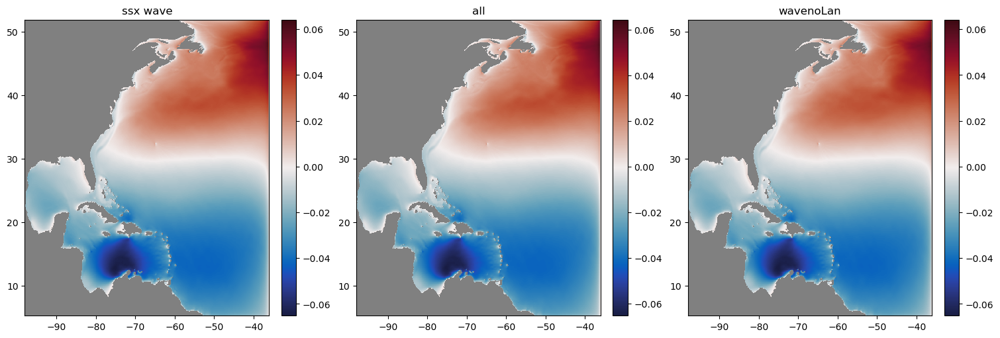

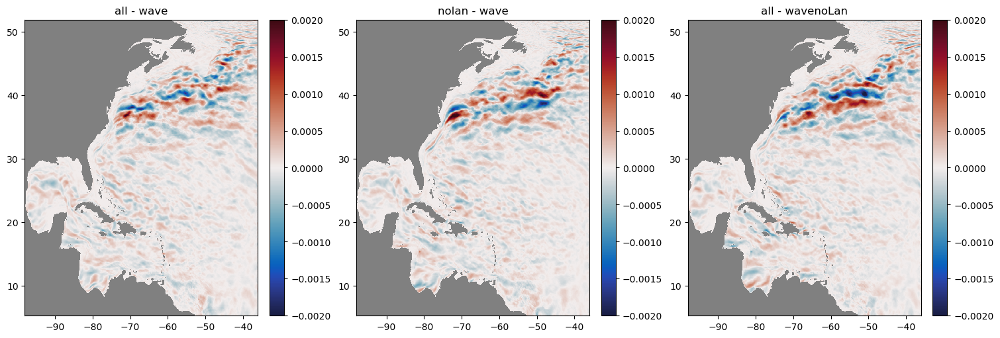

In [26]:

diff_ssx_allnolan_ave=ssx_all_ave - ssx_nolan_ave
diff_ssx_all_ave=ssx_all_ave - ssx_wave_ave
diff_ssx_nolan_ave=ssx_nolan_ave - ssx_wave_ave


fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,ssx_wave_ave , cmap=cmap, shading='auto')
axes[0].set_title('ssx wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssx_all_ave, cmap=cmap, shading='auto')
axes[1].set_title('all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssx_nolan_ave, cmap=cmap, shading='auto')
axes[2].set_title('wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,diff_ssx_all_ave , cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[0].set_title('all - wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssx_nolan_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[1].set_title('nolan - wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssx_allnolan_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('all - wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()

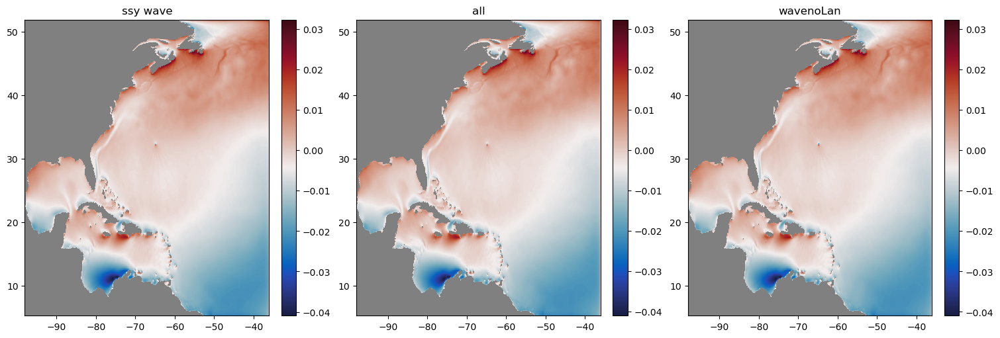

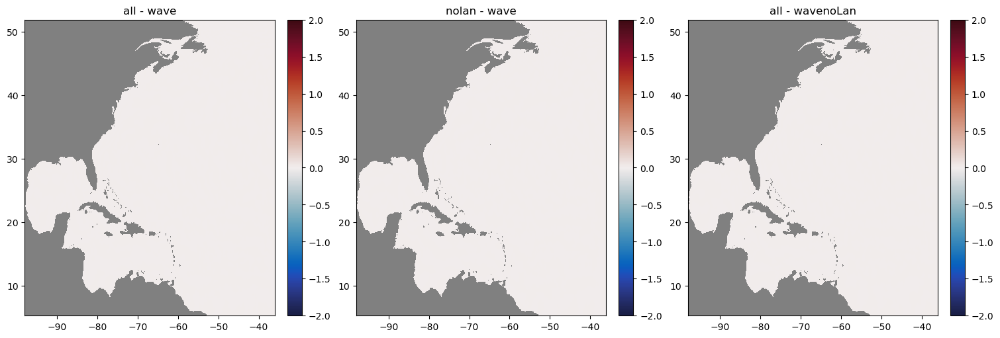

NameError: name 'diff_ssy_uncou_ave' is not defined

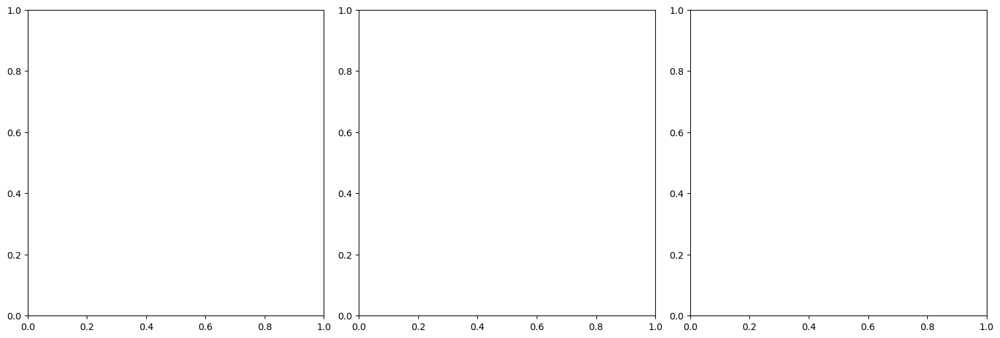

In [27]:



ssy_wave_1=ocean_daily_wave_1.variables['surface_stokes_y']
ssy_wave_2=ocean_daily_wave_2.variables['surface_stokes_y']
ssy_wave_3=ocean_daily_wave_3.variables['surface_stokes_y']
ssy_wave_4=ocean_daily_wave_4.variables['surface_stokes_y']
ssy_wave_5=ocean_daily_wave_5.variables['surface_stokes_y']
ssy_wave_6=ocean_daily_wave_6.variables['surface_stokes_y']
ssy_wave_11=ocean_daily_wave_11.variables['surface_stokes_y']
ssy_wave_22=ocean_daily_wave_22.variables['surface_stokes_y']
ssy_wave_33=ocean_daily_wave_33.variables['surface_stokes_y']
ssy_wave_44=ocean_daily_wave_44.variables['surface_stokes_y']
ssy_wave_55=ocean_daily_wave_55.variables['surface_stokes_y']
ssy_wave_66=ocean_daily_wave_66.variables['surface_stokes_y']
ssy_wave_111=ocean_daily_wave_111.variables['surface_stokes_y']
ssy_wave_222=ocean_daily_wave_222.variables['surface_stokes_y']
ssy_wave_333=ocean_daily_wave_333.variables['surface_stokes_y']
ssy_wave_444=ocean_daily_wave_444.variables['surface_stokes_y']
xr_ssy_wave_1= xarray.DataArray(ssy_wave_1, dims=["time", "yh", "xh"])
xr_ssy_wave_2= xarray.DataArray(ssy_wave_2, dims=["time", "yh", "xh"])
xr_ssy_wave_3= xarray.DataArray(ssy_wave_3, dims=["time", "yh", "xh"])
xr_ssy_wave_4= xarray.DataArray(ssy_wave_4, dims=["time", "yh", "xh"])
xr_ssy_wave_5= xarray.DataArray(ssy_wave_5, dims=["time", "yh", "xh"])
xr_ssy_wave_6= xarray.DataArray(ssy_wave_6, dims=["time", "yh", "xh"])
xr_ssy_wave_11= xarray.DataArray(ssy_wave_11, dims=["time", "yh", "xh"])
xr_ssy_wave_22= xarray.DataArray(ssy_wave_22, dims=["time", "yh", "xh"])
xr_ssy_wave_33= xarray.DataArray(ssy_wave_33, dims=["time", "yh", "xh"])
xr_ssy_wave_44= xarray.DataArray(ssy_wave_44, dims=["time", "yh", "xh"])
xr_ssy_wave_55= xarray.DataArray(ssy_wave_55, dims=["time", "yh", "xh"])
xr_ssy_wave_66= xarray.DataArray(ssy_wave_66, dims=["time", "yh", "xh"])
xr_ssy_wave_111= xarray.DataArray(ssy_wave_111, dims=["time", "yh", "xh"])
xr_ssy_wave_222= xarray.DataArray(ssy_wave_222, dims=["time", "yh", "xh"])
xr_ssy_wave_333= xarray.DataArray(ssy_wave_333, dims=["time", "yh", "xh"])
xr_ssy_wave_444= xarray.DataArray(ssy_wave_444, dims=["time", "yh", "xh"])
ssy_wave=xarray.concat([xr_ssy_wave_1, xr_ssy_wave_2, xr_ssy_wave_3, xr_ssy_wave_4, xr_ssy_wave_5, xr_ssy_wave_6,xr_ssy_wave_11, xr_ssy_wave_22, xr_ssy_wave_33, xr_ssy_wave_44, xr_ssy_wave_55, xr_ssy_wave_66,xr_ssy_wave_111, xr_ssy_wave_222, xr_ssy_wave_333, xr_ssy_wave_444], dim='time')
ssy_wave_ave=ssy_wave.mean('time')[1:,:]


ssy_all_1=ocean_daily_all_1.variables['surface_stokes_y']
ssy_all_2=ocean_daily_all_2.variables['surface_stokes_y']
ssy_all_3=ocean_daily_all_3.variables['surface_stokes_y']
ssy_all_4=ocean_daily_all_4.variables['surface_stokes_y']
ssy_all_5=ocean_daily_all_5.variables['surface_stokes_y']
ssy_all_6=ocean_daily_all_6.variables['surface_stokes_y']
ssy_all_11=ocean_daily_all_11.variables['surface_stokes_y']
ssy_all_22=ocean_daily_all_22.variables['surface_stokes_y']
ssy_all_33=ocean_daily_all_33.variables['surface_stokes_y']
ssy_all_44=ocean_daily_all_44.variables['surface_stokes_y']
ssy_all_55=ocean_daily_all_55.variables['surface_stokes_y']
ssy_all_66=ocean_daily_all_66.variables['surface_stokes_y']
ssy_all_111=ocean_daily_all_111.variables['surface_stokes_y']
ssy_all_222=ocean_daily_all_222.variables['surface_stokes_y']
ssy_all_333=ocean_daily_all_333.variables['surface_stokes_y']
ssy_all_444=ocean_daily_all_444.variables['surface_stokes_y']
xr_ssy_all_1= xarray.DataArray(ssy_all_1, dims=["time", "yh", "xh"])
xr_ssy_all_2= xarray.DataArray(ssy_all_2, dims=["time", "yh", "xh"])
xr_ssy_all_3= xarray.DataArray(ssy_all_3, dims=["time", "yh", "xh"])
xr_ssy_all_4= xarray.DataArray(ssy_all_4, dims=["time", "yh", "xh"])
xr_ssy_all_5= xarray.DataArray(ssy_all_5, dims=["time", "yh", "xh"])
xr_ssy_all_6= xarray.DataArray(ssy_all_6, dims=["time", "yh", "xh"])
xr_ssy_all_11= xarray.DataArray(ssy_all_11, dims=["time", "yh", "xh"])
xr_ssy_all_22= xarray.DataArray(ssy_all_22, dims=["time", "yh", "xh"])
xr_ssy_all_33= xarray.DataArray(ssy_all_33, dims=["time", "yh", "xh"])
xr_ssy_all_44= xarray.DataArray(ssy_all_44, dims=["time", "yh", "xh"])
xr_ssy_all_55= xarray.DataArray(ssy_all_55, dims=["time", "yh", "xh"])
xr_ssy_all_66= xarray.DataArray(ssy_all_66, dims=["time", "yh", "xh"])
xr_ssy_all_111= xarray.DataArray(ssy_all_111, dims=["time", "yh", "xh"])
xr_ssy_all_222= xarray.DataArray(ssy_all_222, dims=["time", "yh", "xh"])
xr_ssy_all_333= xarray.DataArray(ssy_all_333, dims=["time", "yh", "xh"])
xr_ssy_all_444= xarray.DataArray(ssy_all_444, dims=["time", "yh", "xh"])
ssy_all=xarray.concat([xr_ssy_all_1, xr_ssy_all_2, xr_ssy_all_3, xr_ssy_all_4, xr_ssy_all_5, xr_ssy_all_6,xr_ssy_all_11, xr_ssy_all_22, xr_ssy_all_33, xr_ssy_all_44, xr_ssy_all_55, xr_ssy_all_66,xr_ssy_all_111, xr_ssy_all_222, xr_ssy_all_333, xr_ssy_all_444], dim='time')
ssy_all_ave=ssy_all.mean('time')[1:,:]





diff_ssy_all_ave=ssy_all_ave - ssy_wave_ave








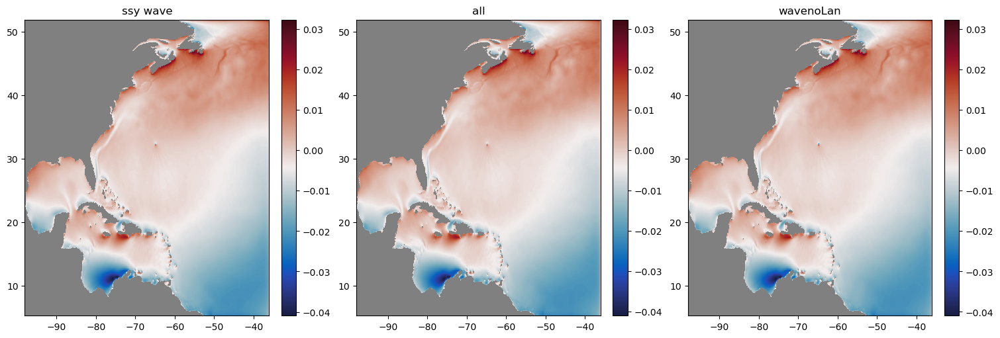

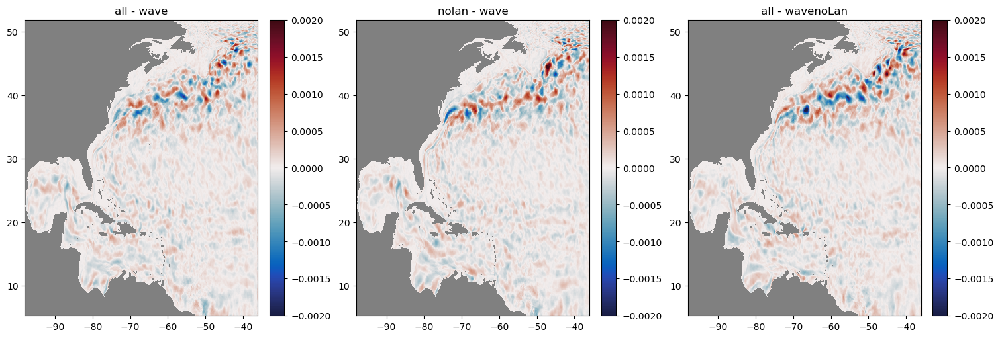

In [29]:

fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,ssy_wave_ave , cmap=cmap, shading='auto')
axes[0].set_title('ssy wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ssy_all_ave, cmap=cmap, shading='auto')
axes[1].set_title('all')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ssy_nolan_ave, cmap=cmap, shading='auto')
axes[2].set_title('wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y,diff_ssy_all_ave , cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[0].set_title('all - wave')
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ssy_nolan_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[1].set_title('nolan - wave')
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ssy_allnolan_ave, cmap=cmap, shading='auto',vmin=-0.002,vmax=0.002)
axes[2].set_title('all - wavenoLan')
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the second plot
# Show the plot
plt.show()


In [30]:
ssu_uncou_1=ocean_daily_uncou_1.variables['ssu']
ssu_uncou_2=ocean_daily_uncou_2.variables['ssu']
ssu_uncou_11=ocean_daily_uncou_11.variables['ssu']
ssu_uncou_22=ocean_daily_uncou_22.variables['ssu']
ssu_uncou_111=ocean_daily_uncou_111.variables['ssu']
ssu_uncou_222=ocean_daily_uncou_222.variables['ssu']

xr_ssu_uncou_1= xarray.DataArray(ssu_uncou_1, dims=["time", "yh", "xh"])
xr_ssu_uncou_2= xarray.DataArray(ssu_uncou_2, dims=["time", "yh", "xh"])
xr_ssu_uncou_11= xarray.DataArray(ssu_uncou_11, dims=["time", "yh", "xh"])
xr_ssu_uncou_22= xarray.DataArray(ssu_uncou_22, dims=["time", "yh", "xh"])
xr_ssu_uncou_111= xarray.DataArray(ssu_uncou_111, dims=["time", "yh", "xh"])
xr_ssu_uncou_222= xarray.DataArray(ssu_uncou_222, dims=["time", "yh", "xh"])
ssu_uncou=xarray.concat([xr_ssu_uncou_1,xr_ssu_uncou_2,xr_ssu_uncou_11,xr_ssu_uncou_22,xr_ssu_uncou_111,xr_ssu_uncou_222], dim='time')
ssu_uncou_ave=ssu_uncou.mean('time')


ssu_uncou_LAfalse_1=ocean_daily_uncou_LAfalse_1.variables['ssu']
ssu_uncou_LAfalse_2=ocean_daily_uncou_LAfalse_2.variables['ssu']
ssu_uncou_LAfalse_11=ocean_daily_uncou_LAfalse_11.variables['ssu']
ssu_uncou_LAfalse_22=ocean_daily_uncou_LAfalse_22.variables['ssu']
ssu_uncou_LAfalse_111=ocean_daily_uncou_LAfalse_111.variables['ssu']
ssu_uncou_LAfalse_222=ocean_daily_uncou_LAfalse_222.variables['ssu']
xr_ssu_uncou_LAfalse_1= xarray.DataArray(ssu_uncou_LAfalse_1, dims=["time", "yh", "xh"])
xr_ssu_uncou_LAfalse_2= xarray.DataArray(ssu_uncou_LAfalse_2, dims=["time", "yh", "xh"])
xr_ssu_uncou_LAfalse_11= xarray.DataArray(ssu_uncou_LAfalse_11, dims=["time", "yh", "xh"])
xr_ssu_uncou_LAfalse_22= xarray.DataArray(ssu_uncou_LAfalse_22, dims=["time", "yh", "xh"])
xr_ssu_uncou_LAfalse_111= xarray.DataArray(ssu_uncou_LAfalse_111, dims=["time", "yh", "xh"])
xr_ssu_uncou_LAfalse_222= xarray.DataArray(ssu_uncou_LAfalse_222, dims=["time", "yh", "xh"])
ssu_uncou_LAfalse=xarray.concat([xr_ssu_uncou_LAfalse_1,xr_ssu_uncou_LAfalse_2,xr_ssu_uncou_LAfalse_11,xr_ssu_uncou_LAfalse_22,xr_ssu_uncou_LAfalse_111,xr_ssu_uncou_LAfalse_222], dim='time')
ssu_uncou_LAfalse_ave=ssu_uncou_LAfalse.mean('time')



ssu_wave_1=ocean_daily_wave_1.variables['ssu']
ssu_wave_2=ocean_daily_wave_2.variables['ssu']
ssu_wave_3=ocean_daily_wave_3.variables['ssu']
ssu_wave_4=ocean_daily_wave_4.variables['ssu']
ssu_wave_5=ocean_daily_wave_5.variables['ssu']
ssu_wave_6=ocean_daily_wave_6.variables['ssu']
ssu_wave_11=ocean_daily_wave_11.variables['ssu']
ssu_wave_22=ocean_daily_wave_22.variables['ssu']
ssu_wave_33=ocean_daily_wave_33.variables['ssu']
ssu_wave_44=ocean_daily_wave_44.variables['ssu']
ssu_wave_55=ocean_daily_wave_55.variables['ssu']
ssu_wave_66=ocean_daily_wave_66.variables['ssu']
ssu_wave_111=ocean_daily_wave_111.variables['ssu']
ssu_wave_222=ocean_daily_wave_222.variables['ssu']
ssu_wave_333=ocean_daily_wave_333.variables['ssu']
ssu_wave_444=ocean_daily_wave_444.variables['ssu']
xr_ssu_wave_1= xarray.DataArray(ssu_wave_1, dims=["time", "yh", "xh"])
xr_ssu_wave_2= xarray.DataArray(ssu_wave_2, dims=["time", "yh", "xh"])
xr_ssu_wave_3= xarray.DataArray(ssu_wave_3, dims=["time", "yh", "xh"])
xr_ssu_wave_4= xarray.DataArray(ssu_wave_4, dims=["time", "yh", "xh"])
xr_ssu_wave_5= xarray.DataArray(ssu_wave_5, dims=["time", "yh", "xh"])
xr_ssu_wave_6= xarray.DataArray(ssu_wave_6, dims=["time", "yh", "xh"])
xr_ssu_wave_11= xarray.DataArray(ssu_wave_11, dims=["time", "yh", "xh"])
xr_ssu_wave_22= xarray.DataArray(ssu_wave_22, dims=["time", "yh", "xh"])
xr_ssu_wave_33= xarray.DataArray(ssu_wave_33, dims=["time", "yh", "xh"])
xr_ssu_wave_44= xarray.DataArray(ssu_wave_44, dims=["time", "yh", "xh"])
xr_ssu_wave_55= xarray.DataArray(ssu_wave_55, dims=["time", "yh", "xh"])
xr_ssu_wave_66= xarray.DataArray(ssu_wave_66, dims=["time", "yh", "xh"])
xr_ssu_wave_111= xarray.DataArray(ssu_wave_111, dims=["time", "yh", "xh"])
xr_ssu_wave_222= xarray.DataArray(ssu_wave_222, dims=["time", "yh", "xh"])
xr_ssu_wave_333= xarray.DataArray(ssu_wave_333, dims=["time", "yh", "xh"])
xr_ssu_wave_444= xarray.DataArray(ssu_wave_444, dims=["time", "yh", "xh"])
ssu_wave=xarray.concat([xr_ssu_wave_1, xr_ssu_wave_2, xr_ssu_wave_3, xr_ssu_wave_4, xr_ssu_wave_5, xr_ssu_wave_6,xr_ssu_wave_11, xr_ssu_wave_22, xr_ssu_wave_33, xr_ssu_wave_44, xr_ssu_wave_55, xr_ssu_wave_66,xr_ssu_wave_111, xr_ssu_wave_222, xr_ssu_wave_333, xr_ssu_wave_444], dim='time')
ssu_wave_ave=ssu_wave.mean('time')


ssu_all_1=ocean_daily_all_1.variables['ssu']
ssu_all_2=ocean_daily_all_2.variables['ssu']
ssu_all_3=ocean_daily_all_3.variables['ssu']
ssu_all_4=ocean_daily_all_4.variables['ssu']
ssu_all_5=ocean_daily_all_5.variables['ssu']
ssu_all_6=ocean_daily_all_6.variables['ssu']
ssu_all_11=ocean_daily_all_11.variables['ssu']
ssu_all_22=ocean_daily_all_22.variables['ssu']
ssu_all_33=ocean_daily_all_33.variables['ssu']
ssu_all_44=ocean_daily_all_44.variables['ssu']
ssu_all_55=ocean_daily_all_55.variables['ssu']
ssu_all_66=ocean_daily_all_66.variables['ssu']
ssu_all_111=ocean_daily_all_111.variables['ssu']
ssu_all_222=ocean_daily_all_222.variables['ssu']
ssu_all_333=ocean_daily_all_333.variables['ssu']
ssu_all_444=ocean_daily_all_444.variables['ssu']
xr_ssu_all_1= xarray.DataArray(ssu_all_1, dims=["time", "yh", "xh"])
xr_ssu_all_2= xarray.DataArray(ssu_all_2, dims=["time", "yh", "xh"])
xr_ssu_all_3= xarray.DataArray(ssu_all_3, dims=["time", "yh", "xh"])
xr_ssu_all_4= xarray.DataArray(ssu_all_4, dims=["time", "yh", "xh"])
xr_ssu_all_5= xarray.DataArray(ssu_all_5, dims=["time", "yh", "xh"])
xr_ssu_all_6= xarray.DataArray(ssu_all_6, dims=["time", "yh", "xh"])
xr_ssu_all_11= xarray.DataArray(ssu_all_11, dims=["time", "yh", "xh"])
xr_ssu_all_22= xarray.DataArray(ssu_all_22, dims=["time", "yh", "xh"])
xr_ssu_all_33= xarray.DataArray(ssu_all_33, dims=["time", "yh", "xh"])
xr_ssu_all_44= xarray.DataArray(ssu_all_44, dims=["time", "yh", "xh"])
xr_ssu_all_55= xarray.DataArray(ssu_all_55, dims=["time", "yh", "xh"])
xr_ssu_all_66= xarray.DataArray(ssu_all_66, dims=["time", "yh", "xh"])
xr_ssu_all_111= xarray.DataArray(ssu_all_111, dims=["time", "yh", "xh"])
xr_ssu_all_222= xarray.DataArray(ssu_all_222, dims=["time", "yh", "xh"])
xr_ssu_all_333= xarray.DataArray(ssu_all_333, dims=["time", "yh", "xh"])
xr_ssu_all_444= xarray.DataArray(ssu_all_444, dims=["time", "yh", "xh"])
ssu_all=xarray.concat([xr_ssu_all_1, xr_ssu_all_2, xr_ssu_all_3, xr_ssu_all_4, xr_ssu_all_5, xr_ssu_all_6,xr_ssu_all_11, xr_ssu_all_22, xr_ssu_all_33, xr_ssu_all_44, xr_ssu_all_55, xr_ssu_all_66,xr_ssu_all_111, xr_ssu_all_222, xr_ssu_all_333, xr_ssu_all_444], dim='time')
ssu_all_ave=ssu_all.mean('time')




ssv_uncou_1=ocean_daily_uncou_1.variables['ssv']
ssv_uncou_2=ocean_daily_uncou_2.variables['ssv']
ssv_uncou_11=ocean_daily_uncou_11.variables['ssv']
ssv_uncou_22=ocean_daily_uncou_22.variables['ssv']
ssv_uncou_111=ocean_daily_uncou_111.variables['ssv']
ssv_uncou_222=ocean_daily_uncou_222.variables['ssv']

xr_ssv_uncou_1= xarray.DataArray(ssv_uncou_1, dims=["time", "yh", "xh"])
xr_ssv_uncou_2= xarray.DataArray(ssv_uncou_2, dims=["time", "yh", "xh"])
xr_ssv_uncou_11= xarray.DataArray(ssv_uncou_11, dims=["time", "yh", "xh"])
xr_ssv_uncou_22= xarray.DataArray(ssv_uncou_22, dims=["time", "yh", "xh"])
xr_ssv_uncou_111= xarray.DataArray(ssv_uncou_111, dims=["time", "yh", "xh"])
xr_ssv_uncou_222= xarray.DataArray(ssv_uncou_222, dims=["time", "yh", "xh"])
ssv_uncou=xarray.concat([xr_ssv_uncou_1,xr_ssv_uncou_2,xr_ssv_uncou_11,xr_ssv_uncou_22,xr_ssv_uncou_111,xr_ssv_uncou_222], dim='time')
ssv_uncou_ave=ssv_uncou.mean('time')


ssv_uncou_LAfalse_1=ocean_daily_uncou_LAfalse_1.variables['ssv']
ssv_uncou_LAfalse_2=ocean_daily_uncou_LAfalse_2.variables['ssv']
ssv_uncou_LAfalse_11=ocean_daily_uncou_LAfalse_11.variables['ssv']
ssv_uncou_LAfalse_22=ocean_daily_uncou_LAfalse_22.variables['ssv']
ssv_uncou_LAfalse_111=ocean_daily_uncou_LAfalse_111.variables['ssv']
ssv_uncou_LAfalse_222=ocean_daily_uncou_LAfalse_222.variables['ssv']
xr_ssv_uncou_LAfalse_1= xarray.DataArray(ssv_uncou_LAfalse_1, dims=["time", "yh", "xh"])
xr_ssv_uncou_LAfalse_2= xarray.DataArray(ssv_uncou_LAfalse_2, dims=["time", "yh", "xh"])
xr_ssv_uncou_LAfalse_11= xarray.DataArray(ssv_uncou_LAfalse_11, dims=["time", "yh", "xh"])
xr_ssv_uncou_LAfalse_22= xarray.DataArray(ssv_uncou_LAfalse_22, dims=["time", "yh", "xh"])
xr_ssv_uncou_LAfalse_111= xarray.DataArray(ssv_uncou_LAfalse_111, dims=["time", "yh", "xh"])
xr_ssv_uncou_LAfalse_222= xarray.DataArray(ssv_uncou_LAfalse_222, dims=["time", "yh", "xh"])
ssv_uncou_LAfalse=xarray.concat([xr_ssv_uncou_LAfalse_1,xr_ssv_uncou_LAfalse_2,xr_ssv_uncou_LAfalse_11,xr_ssv_uncou_LAfalse_22,xr_ssv_uncou_LAfalse_111,xr_ssv_uncou_LAfalse_222], dim='time')
ssv_uncou_LAfalse_ave=ssv_uncou_LAfalse.mean('time')



ssv_wave_1=ocean_daily_wave_1.variables['ssv']
ssv_wave_2=ocean_daily_wave_2.variables['ssv']
ssv_wave_3=ocean_daily_wave_3.variables['ssv']
ssv_wave_4=ocean_daily_wave_4.variables['ssv']
ssv_wave_5=ocean_daily_wave_5.variables['ssv']
ssv_wave_6=ocean_daily_wave_6.variables['ssv']
ssv_wave_11=ocean_daily_wave_11.variables['ssv']
ssv_wave_22=ocean_daily_wave_22.variables['ssv']
ssv_wave_33=ocean_daily_wave_33.variables['ssv']
ssv_wave_44=ocean_daily_wave_44.variables['ssv']
ssv_wave_55=ocean_daily_wave_55.variables['ssv']
ssv_wave_66=ocean_daily_wave_66.variables['ssv']
ssv_wave_111=ocean_daily_wave_111.variables['ssv']
ssv_wave_222=ocean_daily_wave_222.variables['ssv']
ssv_wave_333=ocean_daily_wave_333.variables['ssv']
ssv_wave_444=ocean_daily_wave_444.variables['ssv']
xr_ssv_wave_1= xarray.DataArray(ssv_wave_1, dims=["time", "yh", "xh"])
xr_ssv_wave_2= xarray.DataArray(ssv_wave_2, dims=["time", "yh", "xh"])
xr_ssv_wave_3= xarray.DataArray(ssv_wave_3, dims=["time", "yh", "xh"])
xr_ssv_wave_4= xarray.DataArray(ssv_wave_4, dims=["time", "yh", "xh"])
xr_ssv_wave_5= xarray.DataArray(ssv_wave_5, dims=["time", "yh", "xh"])
xr_ssv_wave_6= xarray.DataArray(ssv_wave_6, dims=["time", "yh", "xh"])
xr_ssv_wave_11= xarray.DataArray(ssv_wave_11, dims=["time", "yh", "xh"])
xr_ssv_wave_22= xarray.DataArray(ssv_wave_22, dims=["time", "yh", "xh"])
xr_ssv_wave_33= xarray.DataArray(ssv_wave_33, dims=["time", "yh", "xh"])
xr_ssv_wave_44= xarray.DataArray(ssv_wave_44, dims=["time", "yh", "xh"])
xr_ssv_wave_55= xarray.DataArray(ssv_wave_55, dims=["time", "yh", "xh"])
xr_ssv_wave_66= xarray.DataArray(ssv_wave_66, dims=["time", "yh", "xh"])
xr_ssv_wave_111= xarray.DataArray(ssv_wave_111, dims=["time", "yh", "xh"])
xr_ssv_wave_222= xarray.DataArray(ssv_wave_222, dims=["time", "yh", "xh"])
xr_ssv_wave_333= xarray.DataArray(ssv_wave_333, dims=["time", "yh", "xh"])
xr_ssv_wave_444= xarray.DataArray(ssv_wave_444, dims=["time", "yh", "xh"])
ssv_wave=xarray.concat([xr_ssv_wave_1, xr_ssv_wave_2, xr_ssv_wave_3, xr_ssv_wave_4, xr_ssv_wave_5, xr_ssv_wave_6,xr_ssv_wave_11, xr_ssv_wave_22, xr_ssv_wave_33, xr_ssv_wave_44, xr_ssv_wave_55, xr_ssv_wave_66,xr_ssv_wave_111, xr_ssv_wave_222, xr_ssv_wave_333, xr_ssv_wave_444], dim='time')
ssv_wave_ave=ssv_wave.mean('time')


ssv_all_1=ocean_daily_all_1.variables['ssv']
ssv_all_2=ocean_daily_all_2.variables['ssv']
ssv_all_3=ocean_daily_all_3.variables['ssv']
ssv_all_4=ocean_daily_all_4.variables['ssv']
ssv_all_5=ocean_daily_all_5.variables['ssv']
ssv_all_6=ocean_daily_all_6.variables['ssv']
ssv_all_11=ocean_daily_all_11.variables['ssv']
ssv_all_22=ocean_daily_all_22.variables['ssv']
ssv_all_33=ocean_daily_all_33.variables['ssv']
ssv_all_44=ocean_daily_all_44.variables['ssv']
ssv_all_55=ocean_daily_all_55.variables['ssv']
ssv_all_66=ocean_daily_all_66.variables['ssv']
ssv_all_111=ocean_daily_all_111.variables['ssv']
ssv_all_222=ocean_daily_all_222.variables['ssv']
ssv_all_333=ocean_daily_all_333.variables['ssv']
ssv_all_444=ocean_daily_all_444.variables['ssv']
xr_ssv_all_1= xarray.DataArray(ssv_all_1, dims=["time", "yh", "xh"])
xr_ssv_all_2= xarray.DataArray(ssv_all_2, dims=["time", "yh", "xh"])
xr_ssv_all_3= xarray.DataArray(ssv_all_3, dims=["time", "yh", "xh"])
xr_ssv_all_4= xarray.DataArray(ssv_all_4, dims=["time", "yh", "xh"])
xr_ssv_all_5= xarray.DataArray(ssv_all_5, dims=["time", "yh", "xh"])
xr_ssv_all_6= xarray.DataArray(ssv_all_6, dims=["time", "yh", "xh"])
xr_ssv_all_11= xarray.DataArray(ssv_all_11, dims=["time", "yh", "xh"])
xr_ssv_all_22= xarray.DataArray(ssv_all_22, dims=["time", "yh", "xh"])
xr_ssv_all_33= xarray.DataArray(ssv_all_33, dims=["time", "yh", "xh"])
xr_ssv_all_44= xarray.DataArray(ssv_all_44, dims=["time", "yh", "xh"])
xr_ssv_all_55= xarray.DataArray(ssv_all_55, dims=["time", "yh", "xh"])
xr_ssv_all_66= xarray.DataArray(ssv_all_66, dims=["time", "yh", "xh"])
xr_ssv_all_111= xarray.DataArray(ssv_all_111, dims=["time", "yh", "xh"])
xr_ssv_all_222= xarray.DataArray(ssv_all_222, dims=["time", "yh", "xh"])
xr_ssv_all_333= xarray.DataArray(ssv_all_333, dims=["time", "yh", "xh"])
xr_ssv_all_444= xarray.DataArray(ssv_all_444, dims=["time", "yh", "xh"])
ssv_all=xarray.concat([xr_ssv_all_1, xr_ssv_all_2, xr_ssv_all_3, xr_ssv_all_4, xr_ssv_all_5, xr_ssv_all_6,xr_ssv_all_11, xr_ssv_all_22, xr_ssv_all_33, xr_ssv_all_44, xr_ssv_all_55, xr_ssv_all_66,xr_ssv_all_111, xr_ssv_all_222, xr_ssv_all_333, xr_ssv_all_444], dim='time')
ssv_all_ave=ssv_all.mean('time')





ssu_wave=ssu_wave[:,:,1:]
ssv_wave=ssv_wave[:,1:,:]
ssu_all=ssu_all[:,:,1:]
ssv_all=ssv_all[:,1:,:]
ssu_nolan=ssu_nolan[:,:,1:]
ssv_nolan=ssv_nolan[:,1:,:]
ssu_uncou=ssu_uncou[:,:,1:]
ssv_uncou=ssv_uncou[:,1:,:]
ssu_uncou_LAfalse=ssu_uncou_LAfalse[:,:,1:]
ssv_uncou_LAfalse=ssv_uncou_LAfalse[:,1:,:]

ss_mag_wave=np.sqrt(ssu_wave**2 + ssv_wave**2)
ss_mag_all=np.sqrt(ssu_all**2 + ssv_all**2)
ss_mag_nolan=np.sqrt(ssu_nolan**2 + ssv_nolan**2)
ss_mag_uncou=np.sqrt(ssu_uncou**2+ ssv_uncou**2)
ss_mag_uncou_LAfalse=np.sqrt(ssu_uncou_LAfalse**2 + ssv_uncou_LAfalse**2)

ss_mag_wave_ave=ss_mag_wave.mean('time')
ss_mag_all_ave=ss_mag_all.mean('time')
ss_mag_nolan_ave=ss_mag_nolan.mean('time')
ss_mag_uncou_ave=ss_mag_uncou.mean('time')
ss_mag_uncou_LAfalse_ave=ss_mag_uncou_LAfalse.mean('time')




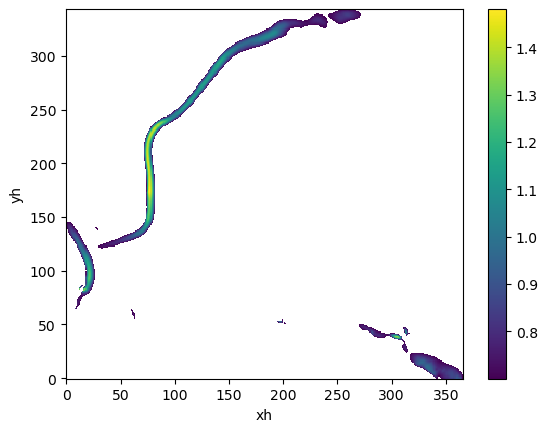

In [10]:

filtered_data = ss_mag_wave_ave.where(ss_mag_wave_ave >= 0.7, drop=True) 
filtered_data.plot(cmap='viridis', add_colorbar=True)


In [10]:
!pip install mplcursors

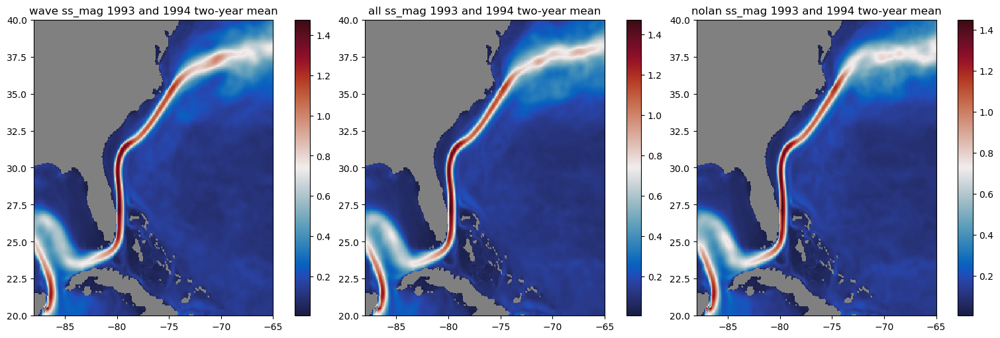

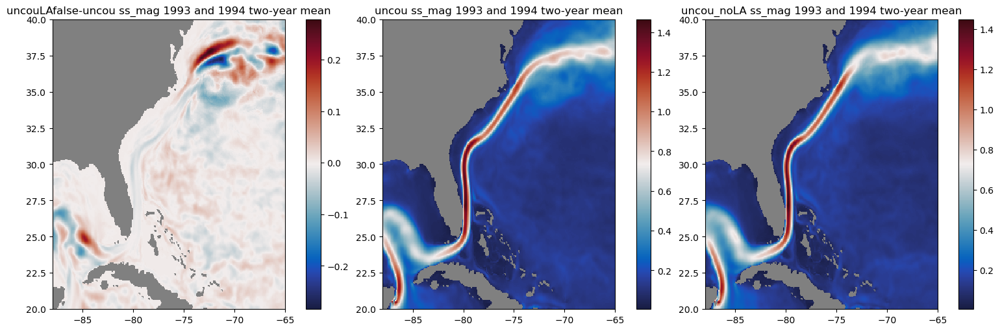

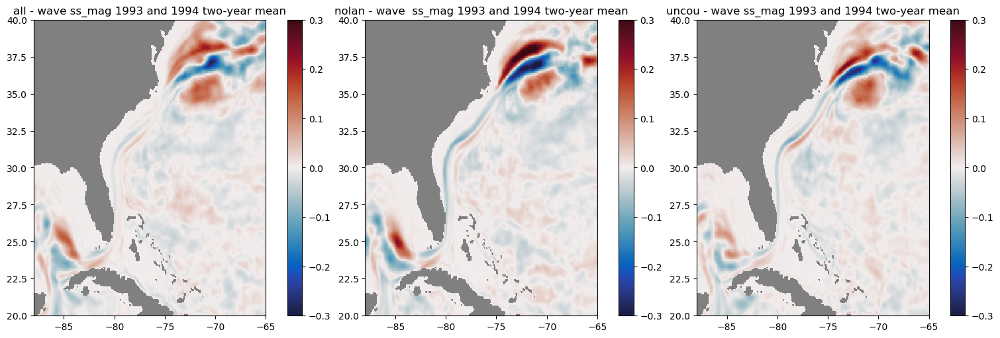

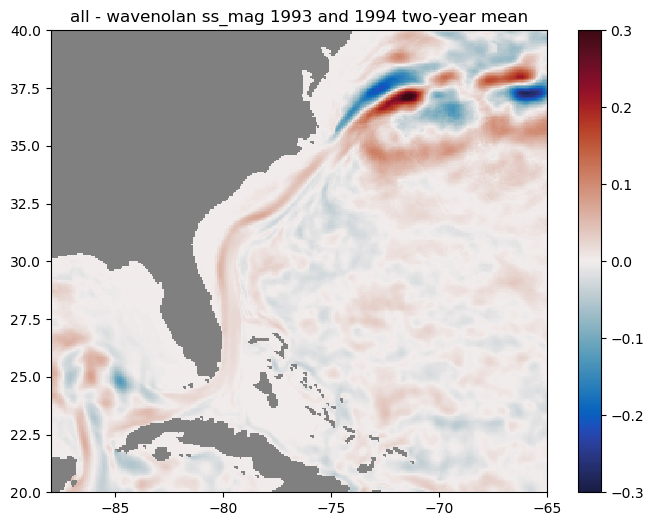

In [32]:
import mplcursors
fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, ss_mag_wave_ave, cmap=cmap, shading='auto')
axes[0].set_title('wave ss_mag 1993 and 1994 two-year mean')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ss_mag_all_ave, cmap=cmap, shading='auto')
axes[1].set_title('all ss_mag 1993 and 1994 two-year mean')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

# Plot the third dataset
mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ss_mag_nolan_ave, cmap=cmap, shading='auto')
axes[2].set_title('nolan ss_mag 1993 and 1994 two-year mean')
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the third plot
plt.show()


fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)
diff_ss_mag_uncou_ave=-1*(ss_mag_uncou_ave - ss_mag_uncou_LAfalse_ave)
# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ss_mag_uncou_ave, cmap=cmap, shading='auto')
axes[0].set_title('uncouLAfalse-uncou ss_mag 1993 and 1994 two-year mean')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, ss_mag_uncou_ave, cmap=cmap, shading='auto')
axes[1].set_title('uncou ss_mag 1993 and 1994 two-year mean')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot

# Plot the third dataset
mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, ss_mag_uncou_LAfalse_ave, cmap=cmap, shading='auto')
axes[2].set_title('uncou_noLA ss_mag 1993 and 1994 two-year mean')
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the third plot
# Show the plot
plt.show()





###show the difference
diff_ss_mag_all_ave=ss_mag_all_ave - ss_mag_wave_ave
diff_ss_mag_nolan_ave=ss_mag_nolan_ave - ss_mag_wave_ave
diff_ss_mag_wave_ave= ss_mag_uncou_ave - ss_mag_wave_ave 
diff_ss_mag_allwave_ave= ss_mag_all_ave - ss_mag_wavenolan_ave


fig, axes = plt.subplots(1, 3, figsize=(15, 5), constrained_layout=True)

# Plot the first dataset
mesh1 = axes[0].pcolormesh(model_grid_x, model_grid_y, diff_ss_mag_all_ave, cmap=cmap, shading='auto',vmin=-0.3,vmax=0.3)
axes[0].set_title('all - wave ss_mag 1993 and 1994 two-year mean')
axes[0].set_xlim([-88, -65])
axes[0].set_ylim([20,40])
plt.colorbar(mesh1, ax=axes[0])  # Add colorbar for the first plot

# Plot the second dataset
mesh2 = axes[1].pcolormesh(model_grid_x, model_grid_y, diff_ss_mag_nolan_ave, cmap=cmap, shading='auto',vmin=-0.3,vmax=0.3)
axes[1].set_title('nolan - wave  ss_mag 1993 and 1994 two-year mean')
axes[1].set_xlim([-88, -65])
axes[1].set_ylim([20,40])
plt.colorbar(mesh2, ax=axes[1])  # Add colorbar for the second plot
clicked_points = []

# Function to store clicked coordinates
def onclick(event):
    if event.xdata is not None and event.ydata is not None:
        coord = (event.xdata, event.ydata)
        clicked_points.append(coord)
        print(f"Selected point: {coord}")

# Connect the event
fig.canvas.mpl_connect('button_press_event', onclick)
    
# Plot the third dataset
mesh3 = axes[2].pcolormesh(model_grid_x, model_grid_y, diff_ss_mag_wave_ave, cmap=cmap, shading='auto',vmin=-0.3,vmax=0.3)
axes[2].set_title('uncou - wave ss_mag 1993 and 1994 two-year mean')
axes[2].set_xlim([-88, -65])
axes[2].set_ylim([20,40])
plt.colorbar(mesh3, ax=axes[2])  # Add colorbar for the third plot
plt.show()

fig, ax = plt.subplots(figsize=(8, 6))
mesh4=ax.pcolormesh(model_grid_x, model_grid_y, diff_ss_mag_allwave_ave, cmap=cmap, shading='auto',vmin=-0.3,vmax=0.3)
ax.set_title('uncou - uncouLAfa ss_mag 1993 and 1994 two-year mean')
ax.set_xlim([-88, -65])
ax.set_ylim([20,40])
plt.colorbar(mesh4,ax=ax)  # Add colorbar for the third plot
# Show the plot
plt.show()

In [ ]:
import numpy as np
import logging
from netCDF4 import Dataset
import xarray as xr
def hs_mean_method(pp_root,model_grid_x,model_grid_y,date):
    date_str=str(date)+"01"
    date_2=str(date+1)
    if (date+2)==199313:
        date_3="199401"
    elif (date+2)==199413:
        date_3="199501"
    else:
        date_3=str(date+2)
    
    ww3_1= Dataset(pp_root+"/"+date_str+"_results/ww3."+date_str+".nc")
    ww3_2= Dataset(pp_root+"/"+date_str+"_results/ww3."+date_2+".nc")
    ww3_3= Dataset(pp_root+"/"+date_str+"_results/ww3."+date_3+".nc")
    # ww3_usp=Dataset(pp_root_wave+"ww3.199301_usp.nc")
    def hs_mean(ww3,model_grid_x,model_grid_y):
    
        hs = ww3.variables['hs'][:]
        t = ww3.variables['time'][:]
        ucur=ww3.variables['ucur'][:]
        vcur=ww3.variables['vcur'][:]
        uwnd=ww3.variables['uwnd'][:]
        vwnd=ww3.variables['vwnd'][:]
        cur=np.sqrt(ucur**2 + vcur**2)
        wnd=np.sqrt(uwnd**2 + vwnd**2)        
        
        da_hs = xr.DataArray(
            hs,
            dims=['time', 'yh', 'xh'],  # Adjust based on your variable's shape
            coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y},  # Define coordinates
            name='hs'  # Optional: Give the variable a name
        )
        hs_mean = da_hs.mean(dim='time')

        da_cur = xr.DataArray(
            cur,
            dims=['time', 'yh', 'xh'],  # Adjust based on your variable's shape
            coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y},  # Define coordinates
            name='cur'  # Optional: Give the variable a name
        )
        cur_mean = da_cur.mean(dim='time')

        da_wnd = xr.DataArray(
            wnd,
            dims=['time', 'yh', 'xh'],  # Adjust based on your variable's shape
            coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y},  # Define coordinates
            name='wnd'  # Optional: Give the variable a name
        )
        wnd_mean = da_wnd.mean(dim='time')
        
        return hs_mean, cur_mean, wnd_mean

    hs_mean_1,cur_mean_1, wnd_mean_1=hs_mean(ww3_1,model_grid_x,model_grid_y)
    hs_mean_2,cur_mean_2, wnd_mean_2=hs_mean(ww3_2,model_grid_x,model_grid_y)
    hs_mean_3,cur_mean_3, wnd_mean_3=hs_mean(ww3_3,model_grid_x,model_grid_y)
    

    hs_mean_method=(hs_mean_1+hs_mean_2+hs_mean_3)/3
    hs_mean_2=(hs_mean_2+hs_mean_3)/2

    cur_mean_method=(cur_mean_1+cur_mean_2+cur_mean_3)/3
    cur_mean_2=(cur_mean_2+cur_mean_3)/2

    wnd_mean_method=(wnd_mean_1+wnd_mean_2+wnd_mean_3)/3
    wnd_mean_2=(wnd_mean_2+wnd_mean_3)/2
    
    return hs_mean_1,hs_mean_2,hs_mean_method,wnd_mean_1,wnd_mean_2,wnd_mean_method,cur_mean_1,cur_mean_2,cur_mean_method
def hs_mean_method_4(pp_root,model_grid_x,model_grid_y,date):
    date_str=str(date)+"01"
    date_2=str(date+1)
    date_3=str(date+2)
    if (date+2)==199513:
        date_4="199601"
    else:
        date_4=str(date+2)
    
    ww3_1= Dataset(pp_root+"/"+date_str+"_results/ww3."+date_str+".nc")
    ww3_2= Dataset(pp_root+"/"+date_str+"_results/ww3."+date_2+".nc")
    ww3_3= Dataset(pp_root+"/"+date_str+"_results/ww3."+date_3+".nc")
    ww3_4= Dataset(pp_root+"/"+date_str+"_results/ww3."+date_4+".nc")
    # ww3_usp=Dataset(pp_root_wave+"ww3.199301_usp.nc")
    def hs_mean(ww3,model_grid_x,model_grid_y):
    
        hs = ww3.variables['hs'][:]
        t = ww3.variables['time'][:]
        ucur=ww3.variables['ucur'][:]
        vcur=ww3.variables['vcur'][:]
        uwnd=ww3.variables['uwnd'][:]
        vwnd=ww3.variables['vwnd'][:]
        cur=np.sqrt(ucur**2 + vcur**2)
        wnd=np.sqrt(uwnd**2 + vwnd**2)        
        
        da_hs = xr.DataArray(
            hs,
            dims=['time', 'yh', 'xh'],  # Adjust based on your variable's shape
            coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y},  # Define coordinates
            name='hs'  # Optional: Give the variable a name
        )
        hs_mean = da_hs.mean(dim='time')

        da_cur = xr.DataArray(
            cur,
            dims=['time', 'yh', 'xh'],  # Adjust based on your variable's shape
            coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y},  # Define coordinates
            name='cur'  # Optional: Give the variable a name
        )
        cur_mean = da_cur.mean(dim='time')

        da_wnd = xr.DataArray(
            wnd,
            dims=['time', 'yh', 'xh'],  # Adjust based on your variable's shape
            coords={'time': t, 'xh': model_grid_x, 'yh': model_grid_y},  # Define coordinates
            name='wnd'  # Optional: Give the variable a name
        )
        wnd_mean = da_wnd.mean(dim='time')
        
        return hs_mean, cur_mean, wnd_mean

    hs_mean_1,cur_mean_1, wnd_mean_1=hs_mean(ww3_1,model_grid_x,model_grid_y)
    hs_mean_2,cur_mean_2, wnd_mean_2=hs_mean(ww3_2,model_grid_x,model_grid_y)
    hs_mean_3,cur_mean_3, wnd_mean_3=hs_mean(ww3_3,model_grid_x,model_grid_y)
    hs_mean_4,cur_mean_4, wnd_mean_4=hs_mean(ww3_4,model_grid_x,model_grid_y)    

    hs_mean_method=(hs_mean_1+hs_mean_2+hs_mean_3+hs_mean_4)/4
    hs_mean_2=(hs_mean_2+hs_mean_3)/2

    cur_mean_method=(cur_mean_1+cur_mean_2+cur_mean_3+cur_mean_4)/4
    cur_mean_2=(cur_mean_2+cur_mean_3)/2

    wnd_mean_method=(wnd_mean_1+wnd_mean_2+wnd_mean_3+wnd_mean_4)/4
    wnd_mean_2=(wnd_mean_2+wnd_mean_3)/2
    
    return hs_mean_1,hs_mean_2,hs_mean_method,wnd_mean_1,wnd_mean_2,wnd_mean_method,cur_mean_1,cur_mean_2,cur_mean_method

def hs_mean_annual(pp_root,model_grid_x,model_grid_y):
    _,_,hs_mean_1,_,_,wnd_mean_1,_,_,cur_mean_1=hs_mean_method(pp_root,model_grid_x,model_grid_y,199301)
    _,_,hs_mean_2,_,_,wnd_mean_2,_,_,cur_mean_2=hs_mean_method(pp_root,model_grid_x,model_grid_y,199303)   
    _,_,hs_mean_3,_,_,wnd_mean_3,_,_,cur_mean_3=hs_mean_method(pp_root,model_grid_x,model_grid_y,199305)
    _,_,hs_mean_4,_,_,wnd_mean_4,_,_,cur_mean_4=hs_mean_method(pp_root,model_grid_x,model_grid_y,199307)
    _,_,hs_mean_5,_,_,wnd_mean_5,_,_,cur_mean_5=hs_mean_method(pp_root,model_grid_x,model_grid_y,199309)
    _,_,hs_mean_6,_,_,wnd_mean_6,_,_,cur_mean_6=hs_mean_method(pp_root,model_grid_x,model_grid_y,199311)    
    _,_,hs_mean_11,_,_,wnd_mean_11,_,_,cur_mean_11=hs_mean_method(pp_root,model_grid_x,model_grid_y,199401)
    _,_,hs_mean_22,_,_,wnd_mean_22,_,_,cur_mean_22=hs_mean_method(pp_root,model_grid_x,model_grid_y,199403)   
    _,_,hs_mean_33,_,_,wnd_mean_33,_,_,cur_mean_33=hs_mean_method(pp_root,model_grid_x,model_grid_y,199405)
    _,_,hs_mean_44,_,_,wnd_mean_44,_,_,cur_mean_44=hs_mean_method(pp_root,model_grid_x,model_grid_y,199407)
    _,_,hs_mean_55,_,_,wnd_mean_55,_,_,cur_mean_55=hs_mean_method(pp_root,model_grid_x,model_grid_y,199409)
    _,_,hs_mean_66,_,_,wnd_mean_66,_,_,cur_mean_66=hs_mean_method(pp_root,model_grid_x,model_grid_y,199411)  
    _,_,hs_mean_111,_,_,wnd_mean_111,_,_,cur_mean_111=hs_mean_method_4(pp_root,model_grid_x,model_grid_y,199501)
    _,_,hs_mean_222,_,_,wnd_mean_222,_,_,cur_mean_222=hs_mean_method_4(pp_root,model_grid_x,model_grid_y,199504)    
    _,_,hs_mean_333,_,_,wnd_mean_333,_,_,cur_mean_333=hs_mean_method_4(pp_root,model_grid_x,model_grid_y,199507)  
    _,_,hs_mean_444,_,_,wnd_mean_444,_,_,cur_mean_333=hs_mean_method_4(pp_root,model_grid_x,model_grid_y,199510) 
    hs_mean=(hs_mean_1+hs_mean_2+hs_mean_3+hs_mean_4+hs_mean_5+hs_mean_6+hs_mean_11+hs_mean_22+hs_mean_33+hs_mean_44+hs_mean_55+hs_mean_66+hs_mean_111+hs_mean_222+hs_mean_333)/16
    wnd_mean=(wnd_mean_1+wnd_mean_2+wnd_mean_3+wnd_mean_4+wnd_mean_5+wnd_mean_6+wnd_mean_11+wnd_mean_22+wnd_mean_33+wnd_mean_44+wnd_mean_55+wnd_mean_66+wnd_mean_111+wnd_mean_222+wnd_mean_333)/16
    cur_mean=(cur_mean_1+cur_mean_2+cur_mean_3+cur_mean_4+cur_mean_5+cur_mean_6+cur_mean_11+cur_mean_22+cur_mean_33+cur_mean_44+cur_mean_55+cur_mean_66+cur_mean_111+cur_mean_222+cur_mean_333)/16
    return hs_mean, wnd_mean, cur_mean


    
hs_mean_wave,wnd_mean_wave, cur_mean_wave=hs_mean_annual(pp_root_wave,model_grid_x,model_grid_y)    
hs_mean_all,wnd_mean_all, cur_mean_all=hs_mean_annual(pp_root_all,model_grid_x,model_grid_y)    





/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)
/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)
/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)
/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)
/home/Qian.Xiao/miniconda3/envs/mom6py/lib/python3.12/site-packages/numpy/ma/core.py:6980: RuntimeWarning: overflow encountered in power
  result = np.where(m, fa, umath.power(fa, fb)).view(basetype)


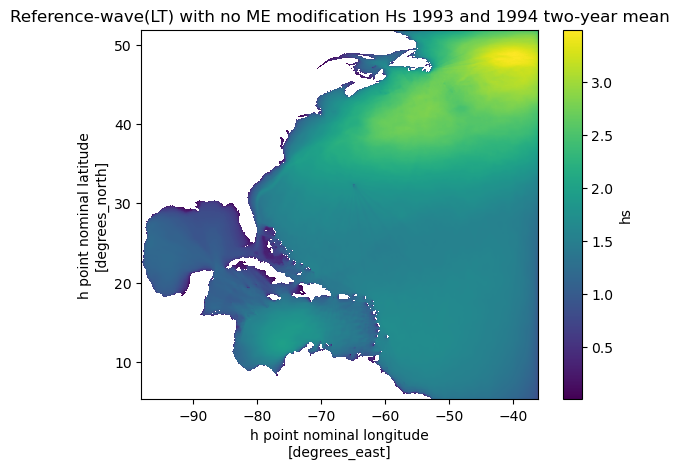

<Figure size 640x480 with 0 Axes>

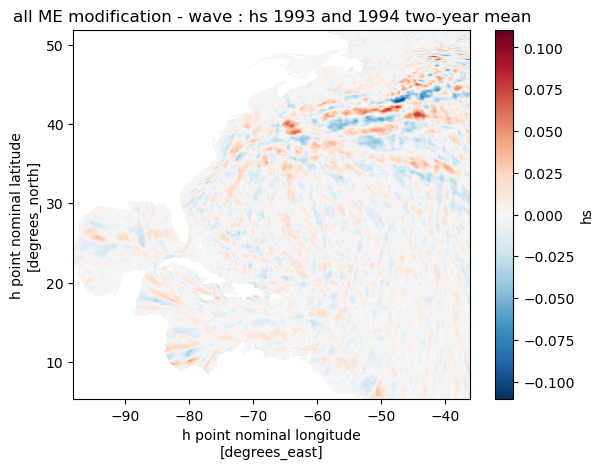

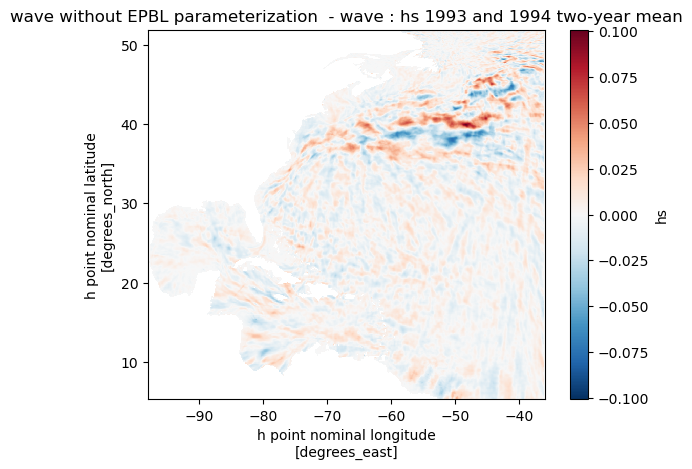

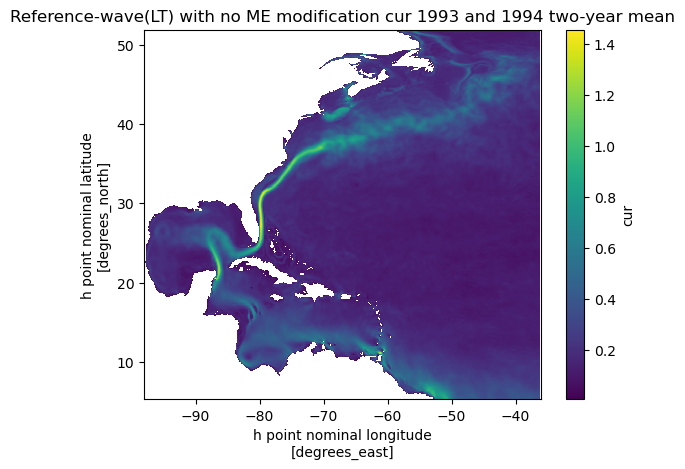

<Figure size 640x480 with 0 Axes>

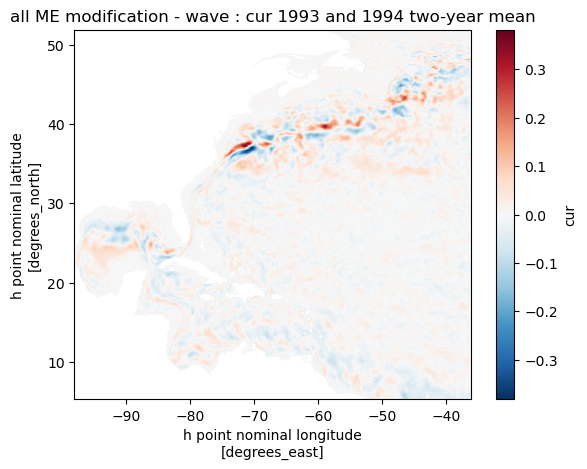

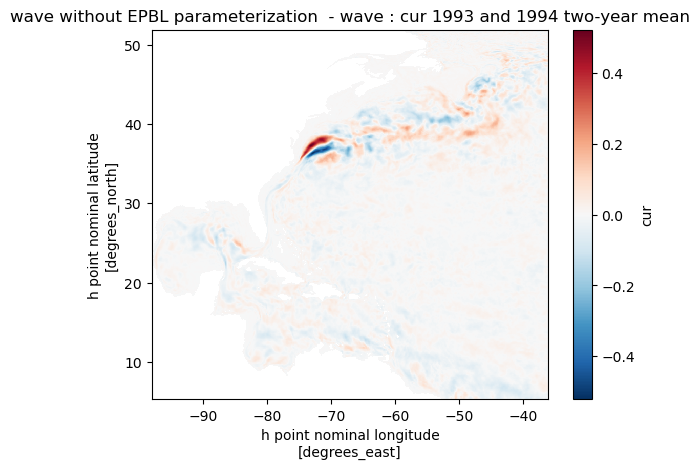

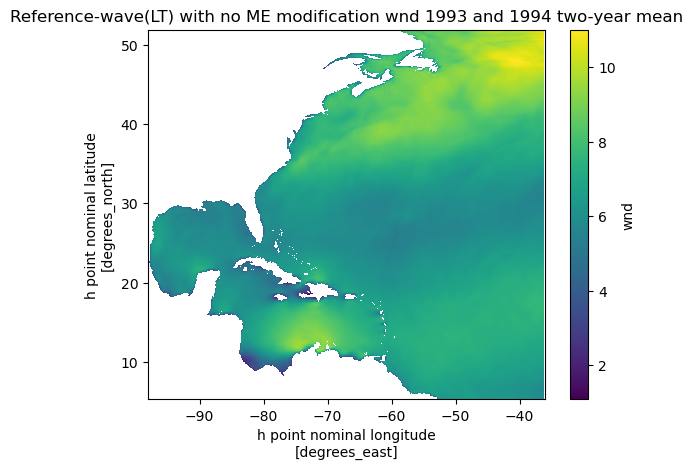

<Figure size 640x480 with 0 Axes>

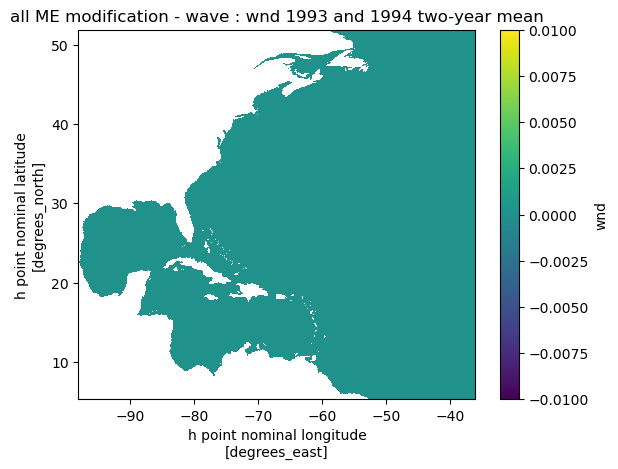

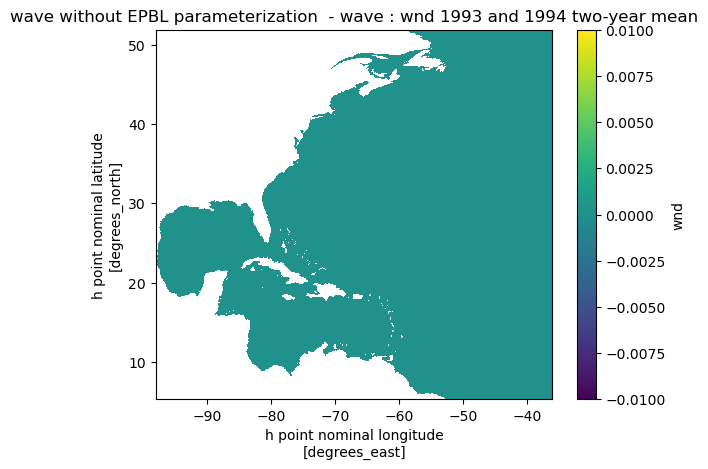

In [16]:

plt.figure()
hs_mean_wave.plot()
plt.title('Reference-wave(LT) with no ME modification Hs 1993 and 1994 two-year mean')
plt.show()
plt.figure()

diff_hs_all=hs_mean_all - hs_mean_wave
plt.figure()
diff_hs_all.plot()
plt.title('all ME modification - wave : hs 1993 and 1994 two-year mean')
plt.show()

diff_hs_nolan=hs_mean_nolan - hs_mean_wave
plt.figure()
diff_hs_nolan.plot()
plt.title('wave without EPBL parameterization  - wave : hs 1993 and 1994 two-year mean')
plt.show()

plt.figure()
cur_mean_wave.plot()
plt.title('Reference-wave(LT) with no ME modification cur 1993 and 1994 two-year mean')
plt.show()
plt.figure()

diff_cur_all=cur_mean_all - cur_mean_wave
plt.figure()
diff_cur_all.plot()
plt.title('all ME modification - wave : cur 1993 and 1994 two-year mean')
plt.show()


diff_cur_nolan=cur_mean_nolan - cur_mean_wave
plt.figure()
diff_cur_nolan.plot()
plt.title('wave without EPBL parameterization  - wave : cur 1993 and 1994 two-year mean')
plt.show()

plt.figure()
wnd_mean_wave.plot()
plt.title('Reference-wave(LT) with no ME modification wnd 1993 and 1994 two-year mean')
plt.show()
plt.figure()

diff_wnd_all=wnd_mean_all - wnd_mean_wave
plt.figure()
diff_wnd_all.plot(vmin=-0.01,vmax=0.01)
plt.title('all ME modification - wave : wnd 1993 and 1994 two-year mean')
plt.show()

diff_wnd_nolan=wnd_mean_nolan - wnd_mean_wave
plt.figure()
diff_wnd_nolan.plot(vmin=-0.01,vmax=0.01)
plt.title('wave without EPBL parameterization  - wave : wnd 1993 and 1994 two-year mean')
plt.show()